In [1]:
import os, sys, time, tqdm, importlib, pickle
import numpy as np
import pandas as pd
import pathlib
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import style
import seaborn as sns
import scanpy as sc
import spatialdata as sd
import squidpy as sq
import scipy.stats as ss
from scipy.spatial.distance import cdist
import gseapy

import warnings
warnings.filterwarnings('ignore')

style.use('seaborn-v0_8-white')
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 500)

/home/xiaojiashun/anaconda3/envs/SpatialScope/lib/python3.9/site-packages/dask/dataframe/_pyarrow_compat.py:15: FutureWarning: Minimal version of pyarrow will soon be increased to 14.0.1. You are using 9.0.0. Please consider upgrading.
  warnings.warn(


In [2]:
## ct map
ct_map = {'B_GC': ['B_Cycling', 'B_GC_DZ', 'B_GC_LZ', 'B_GC_prePB'],
          'B_mem': ['B_IFN', 'B_activated', 'B_mem', 'B_naive', 'B_preGC'],
          'B_plasma': ['B_plasma'],
          'DC': ['DC_CCR7+', 'DC_cDC1', 'DC_cDC2', 'DC_pDC'],
          'Endo': ['Endo'],
          'FDC': ['FDC'],
          'ILC': ['ILC'],
          'Macrophaeges': ['Macrophages_M1', 'Macrophages_M2'],
          'Myeloids': ['Mast', 'Monocytes'],
          'NK': ['NK'],
          'T': ['NKT', 'T_CD4+', 'T_CD4+_TfH', 'T_CD4+_TfH_GC', 'T_CD8+_CD161+', 'T_CD8+_cytotoxic', 'T_TIM3+', 'T_TfR', 'T_Treg'],
          'T_naive': ['T_CD4+_naive', 'T_CD8+_naive'],
          'Stromal': ['VSMC']}
ct_map_inv = {}
for k, v in ct_map.items():
    for x in v:
        ct_map_inv[x] = k

In [3]:
import utils
importlib.reload(utils)
from utils import *

# Data

In [4]:
crop_id = 1

## Preprocess

### Label and basic preprocess

In [5]:
data_dir = '/data2/xiaojiashun/niche/data/Xenium/Xenium_Prime_Human_Lymph_Node_Reactive_FFPE_outs/three_crops'

In [6]:
crop = sc.read(f'{data_dir}/crop{crop_id}_raw.h5ad')
print(f'Raw: {len(crop)} cells.')

Raw: 197644 cells.


In [7]:
crop

AnnData object with n_obs × n_vars = 197644 × 4624
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'region', 'z_level', 'cell_labels', 'x', 'y', 'group'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [8]:
## cell type label
chunk1 = pd.read_csv(f'{data_dir}/cell2location_info_crop{crop_id}_chunk1.csv', sep='\t', index_col=0)
chunk2 = pd.read_csv(f'{data_dir}/cell2location_info_crop{crop_id}_chunk2.csv', sep='\t', index_col=0)
chunks = pd.concat([chunk1, chunk2], axis=0)
chunks.index = chunks.index.astype(str)
print(chunk1.shape, chunk2.shape, chunks.shape)
chunks['sub_cell_type'] = chunks['cell_type']
chunks['cell_type'] = chunks['sub_cell_type'].map(ct_map_inv)
obs = crop.obs.copy()
merge = pd.merge(obs, chunks[['max_abun', 'max_norm', 'cell_type', 'sub_cell_type']], 
                 left_index=True, right_index=True, how='left')
crop.obs = merge.copy()
crop.obs['cell_type'] = crop.obs['cell_type'].astype('category')
crop.obs['sub_cell_type'] = crop.obs['sub_cell_type'].astype('category')

(100000, 40) (97644, 40) (197644, 40)


In [9]:
crop.obs.groupby('cell_type').size()

cell_type
B_GC            11503
B_mem           23979
B_plasma        10165
DC              12585
Endo            20429
FDC              4077
ILC               537
Macrophaeges    19292
Myeloids         1840
NK               2111
Stromal         25688
T               26623
T_naive         38815
dtype: int64

In [10]:
## basic preprocess
np.unique(crop.obs.nucleus_count, return_counts=True)

(array([0., 1., 2., 3., 4., 5., 6., 7.]),
 array([  1934, 183756,  10848,    996,     98,     10,      1,      1]))

In [11]:
sc.pp.filter_cells(crop, min_counts=100)
sc.pp.filter_cells(crop, max_counts=5000)
sc.pp.filter_genes(crop, min_cells=5)
crop

AnnData object with n_obs × n_vars = 177165 × 4622
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'region', 'z_level', 'cell_labels', 'x', 'y', 'group', 'max_abun', 'max_norm', 'cell_type', 'sub_cell_type', 'n_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

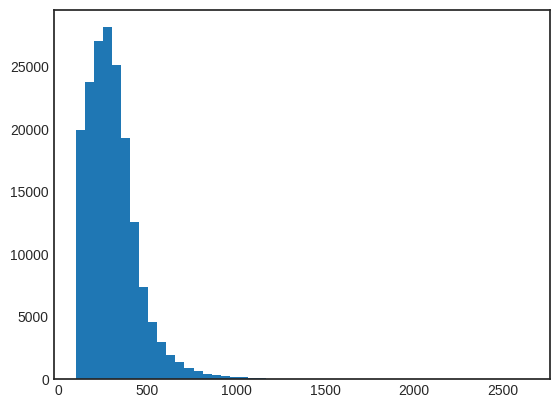

In [12]:
plt.hist(np.array(crop.X.sum(1))[:,0], bins=50)
plt.show()

In [13]:
np.median(np.array(crop.X.sum(1))[0])

214.0

In [14]:
crop.raw = crop
crop.layers['counts'] = crop.X.copy()
t0 = time.time()
sc.pp.normalize_total(crop)
sc.pp.highly_variable_genes(crop, flavor='seurat_v3',n_top_genes=3000)
sc.pp.log1p(crop)
sc.pp.pca(crop, svd_solver='arpack', n_comps=30, use_highly_variable=True)
sc.pp.neighbors(crop, metric='cosine', n_neighbors=30, n_pcs = 30)
sc.tl.umap(crop)
print(f'{time.time() - t0:.1f}s')

108.9s


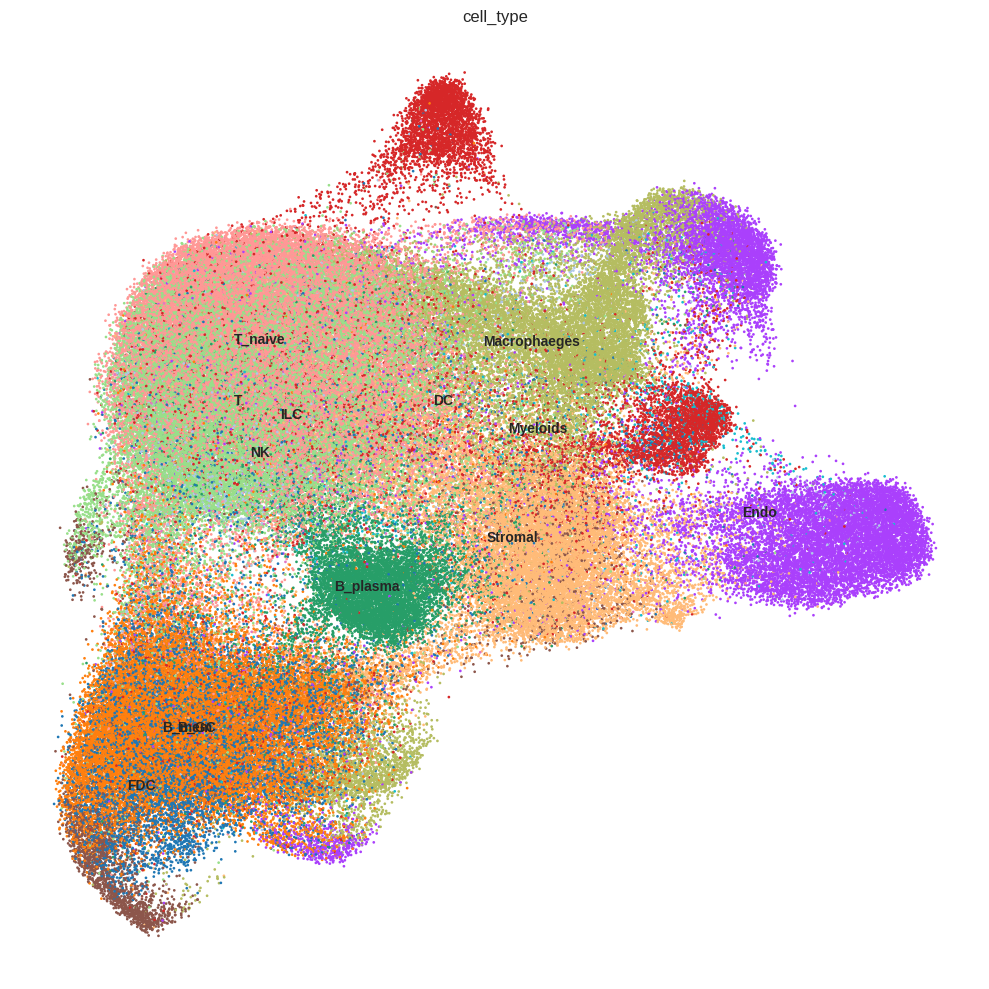

In [15]:
fig, axs = plt.subplots(1, 1, figsize=(10, 10))
sc.pl.umap(crop,  size=15, color='cell_type', frameon=False, show=False, ax=axs,legend_loc='on data')
plt.tight_layout()

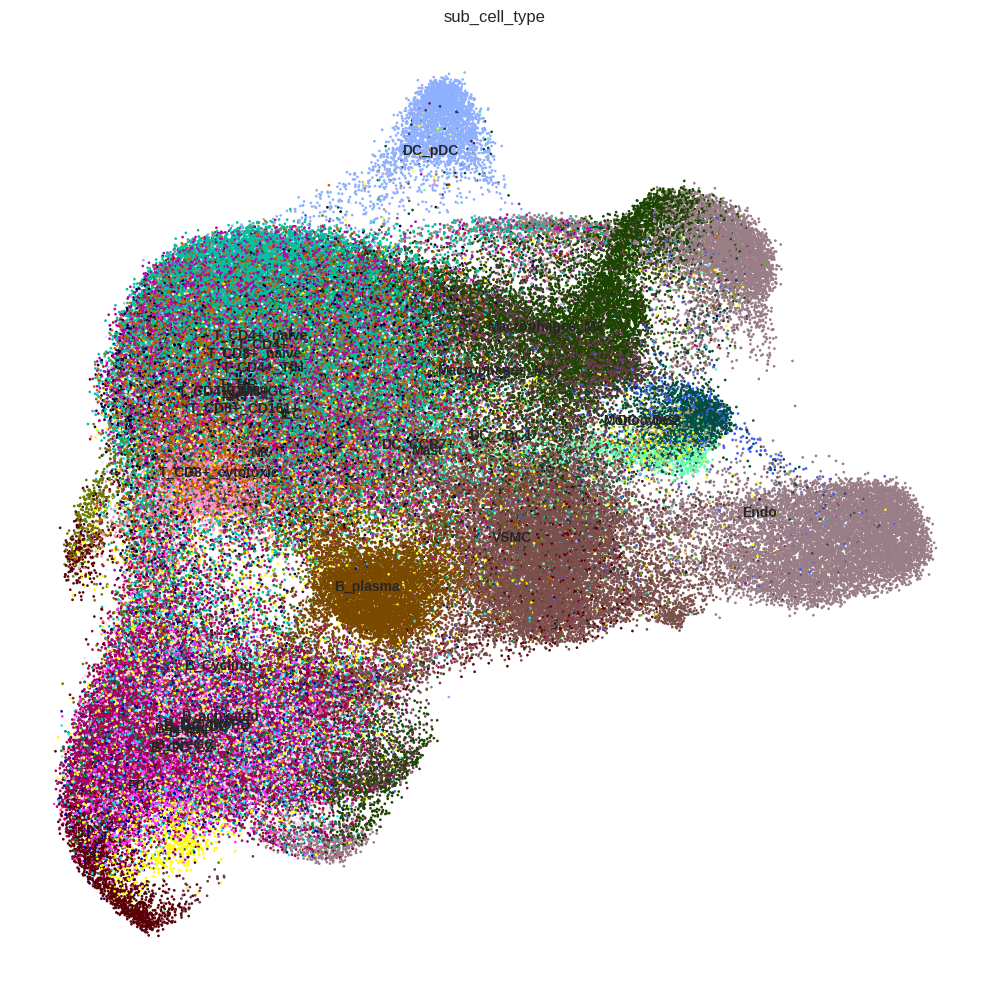

In [16]:
fig, axs = plt.subplots(1, 1, figsize=(10, 10))
sc.pl.umap(crop,  size=15, color='sub_cell_type', frameon=False, show=False, ax=axs,legend_loc='on data')
plt.tight_layout()

In [17]:
crop.X.max(), crop.layers['counts'].max()

(3.9056683, 110.0)

In [18]:
print(f'After basic preprocessing: {len(crop)} cells.')

After basic preprocessing: 177165 cells.


In [19]:
## save crop after prepro
crop.write(f'{data_dir}/crop{crop_id}_prepro.h5ad')

### QC

In [24]:
## load crop with prepro
crop = sc.read(f'{data_dir}/crop{crop_id}_prepro.h5ad')
print(f'Before QC: {len(crop)} cells.')

Before QC: 177165 cells.


In [25]:
## qc by label confidence
conf = 0.3
obs = crop.obs.copy()
qc_df = obs.loc[obs['max_norm']>conf]
qc_df = qc_df.groupby('cell_type').filter(lambda x: len(x) >= 100)
qc_df = qc_df.groupby('sub_cell_type').filter(lambda x: len(x) >= 100)
obs['pass_qc'] = False
obs.loc[qc_df.index,'pass_qc'] = True
crop.obs = obs.copy()
crop = crop[crop.obs.pass_qc==True,:]
# crop = crop[crop.obs.cell_type!='VSMC']
print(f'After QC: {len(crop)} cells.')

After QC: 80534 cells.


In [26]:
## save crop after qc
crop.write(f"{data_dir}/crop{crop_id}_conf{str(conf).replace('.','')}.h5ad")

## QC summary

In [27]:
all_cts = crop.obs.cell_type.cat.categories
crop.obs.groupby('cell_type')['max_norm'].agg(['size', 'median'])

,size,median
cell_type,,
B_GC,4650,0.464304
B_mem,8135,0.443499
B_plasma,6986,0.740214
DC,8077,0.664469
Endo,14410,0.731220
FDC,2132,0.473824
ILC,182,0.527029
Macrophaeges,10420,0.514349
Myeloids,919,0.619995


In [28]:
all_subcts = crop.obs.sub_cell_type.cat.categories
print(len(all_subcts))
crop.obs.groupby('sub_cell_type')['max_norm'].agg(['size', 'median'])

30


,size,median
sub_cell_type,,
B_Cycling,1897,0.526432
B_GC_DZ,762,0.400525
B_GC_LZ,1991,0.442811
B_IFN,681,0.393598
B_activated,124,0.370434
B_mem,5749,0.457962
B_naive,933,0.402943
B_plasma,6986,0.740214
B_preGC,648,0.462105


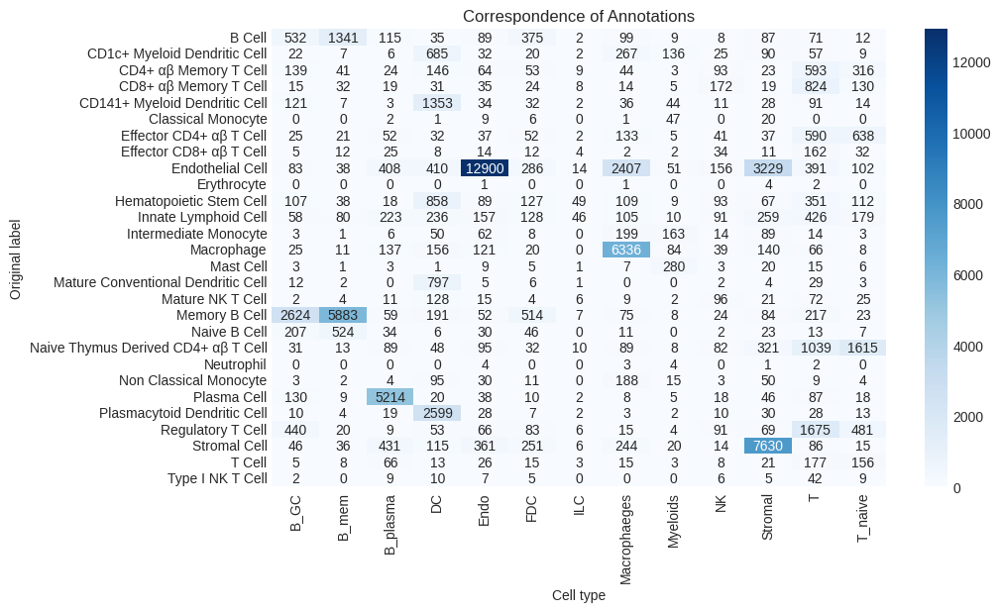

In [29]:
# Create a contingency matrix
contingency_matrix = pd.crosstab(crop.obs['group'],crop.obs['cell_type'])

# Plotting the heatmap
plt.figure(figsize=(10, 6), dpi=100)
sns.heatmap(contingency_matrix, annot=True, fmt='d', cmap='Blues')
plt.title('Correspondence of Annotations')
plt.xlabel('Cell type')
plt.ylabel('Original label')
plt.show()

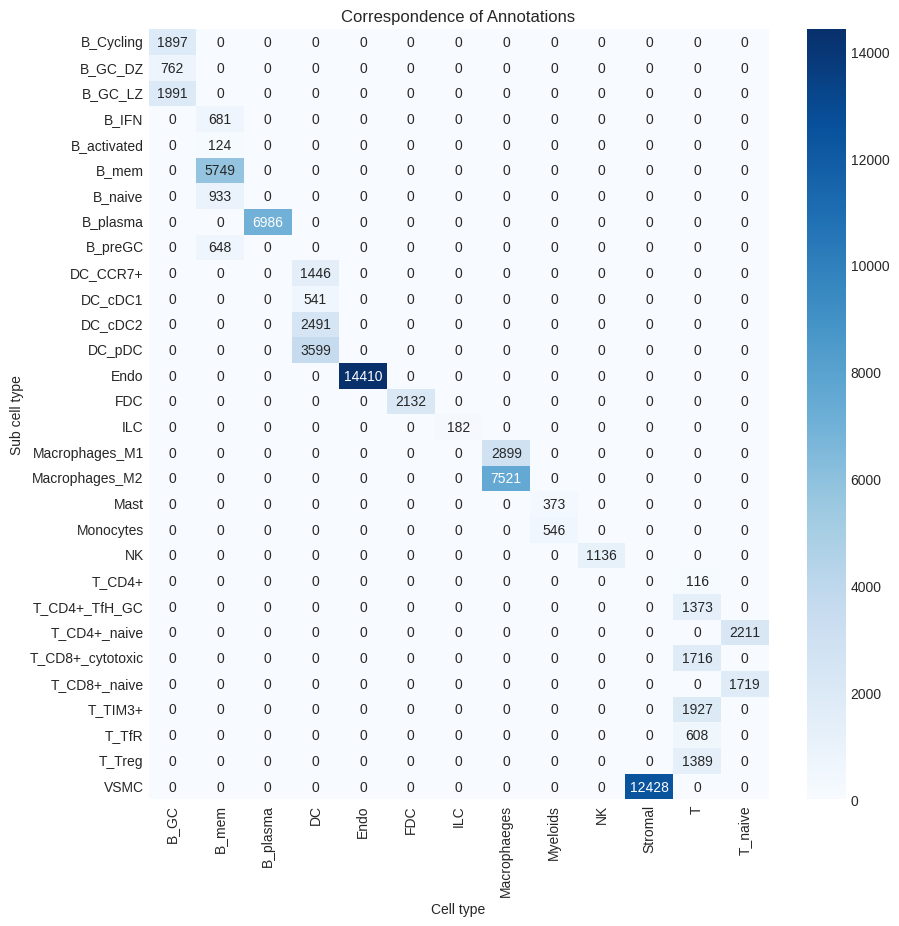

In [30]:
# Create a contingency matrix
contingency_matrix = pd.crosstab(crop.obs['sub_cell_type'],crop.obs['cell_type'])

# Plotting the heatmap
plt.figure(figsize=(10, 10), dpi=100)
sns.heatmap(contingency_matrix, annot=True, fmt='d', cmap='Blues')
plt.title('Correspondence of Annotations')
plt.xlabel('Cell type')
plt.ylabel('Sub cell type')
plt.show()

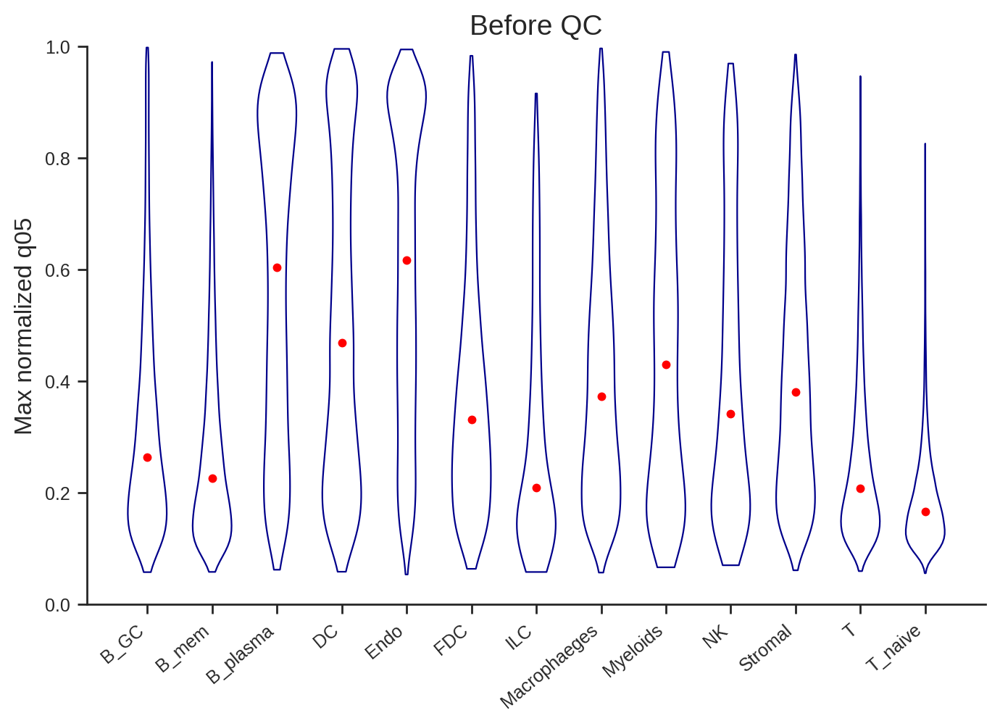

In [31]:
sns.set_context('paper',font_scale=1)
fig, ax = plt.subplots(1, 1, figsize=(8, 5), dpi=200)
width = 0.6
df = chunks[['cell_type', 'max_norm']].copy()
xticks = df.groupby('cell_type').median().index.values
for i, k in enumerate(xticks):
    v_plot = df.loc[df.cell_type==k,'max_norm'].values
    vio1 = ax.violinplot(v_plot, positions=[i], widths=width, 
                         showextrema=False, showmedians=False,showmeans=False)
    for pc in vio1['bodies']:
        pc.set_facecolor('none')
        pc.set_edgecolor('darkblue')
        pc.set_alpha(1)
    means = np.mean(v_plot)
    quartile1, medians, quartile3 = np.percentile(v_plot, [25, 50, 75])
    ax.scatter([i], [medians], marker='o', color='red', s=12, zorder=4)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_ylabel('Max normalized q05', fontsize=12)
ax.set_xticks(range(len(xticks)))
ax.set_xticklabels(xticks, rotation=40, ha='right')
ax.set_title('Before QC', fontsize=14)
ax.set_ylim((0,1))
ax.tick_params(axis='both', which='major', labelsize=9)

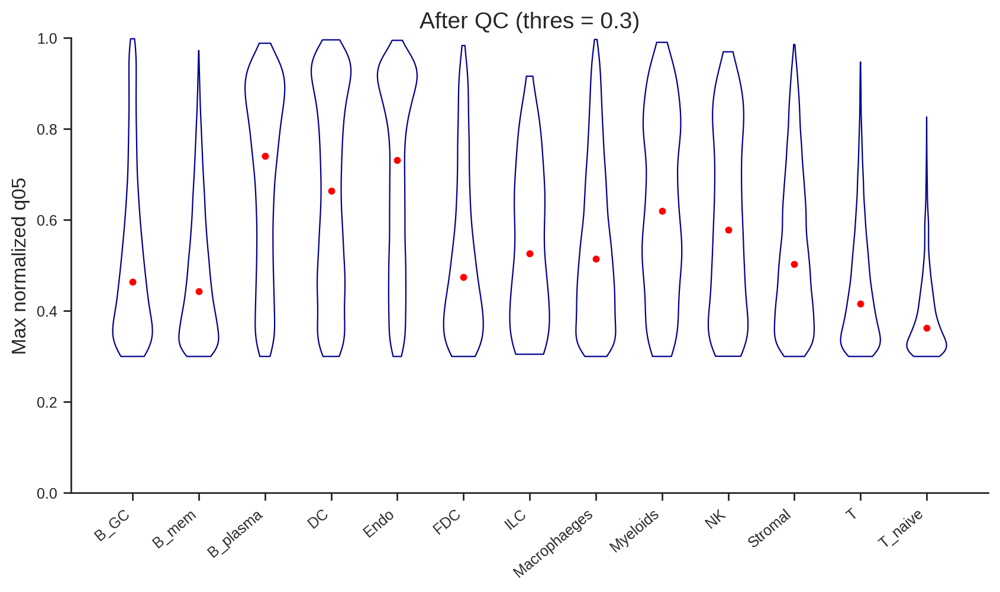

In [32]:
sns.set_context('paper',font_scale=1)
fig, ax = plt.subplots(1, 1, figsize=(10, 5), dpi=200)
width = 0.6
df = qc_df[['cell_type', 'max_norm']].copy()
xticks = df.groupby('cell_type').median().index.values
# xticks = df.groupby('cell_type').median().sort_values('max', ascending=False).index.values
for i, k in enumerate(xticks):
    v_plot = df.loc[df.cell_type==k,'max_norm'].values
    vio1 = ax.violinplot(v_plot, positions=[i], widths=width, 
                         showextrema=False, showmedians=False,showmeans=False)
    for pc in vio1['bodies']:
        pc.set_facecolor('none')
        pc.set_edgecolor('darkblue')
        pc.set_alpha(1)
    means = np.mean(v_plot)
    quartile1, medians, quartile3 = np.percentile(v_plot, [25, 50, 75])
    ax.scatter([i], [medians], marker='o', color='red', s=12, zorder=4)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_ylabel('Max normalized q05', fontsize=12)
ax.set_xticks(range(len(xticks)))
ax.set_xticklabels(xticks, rotation=40, ha='right')
ax.set_ylim((0,1))
ax.set_title(f'After QC (thres = {conf})', fontsize=14)
ax.tick_params(axis='both', which='major', labelsize=9)

## Visualize

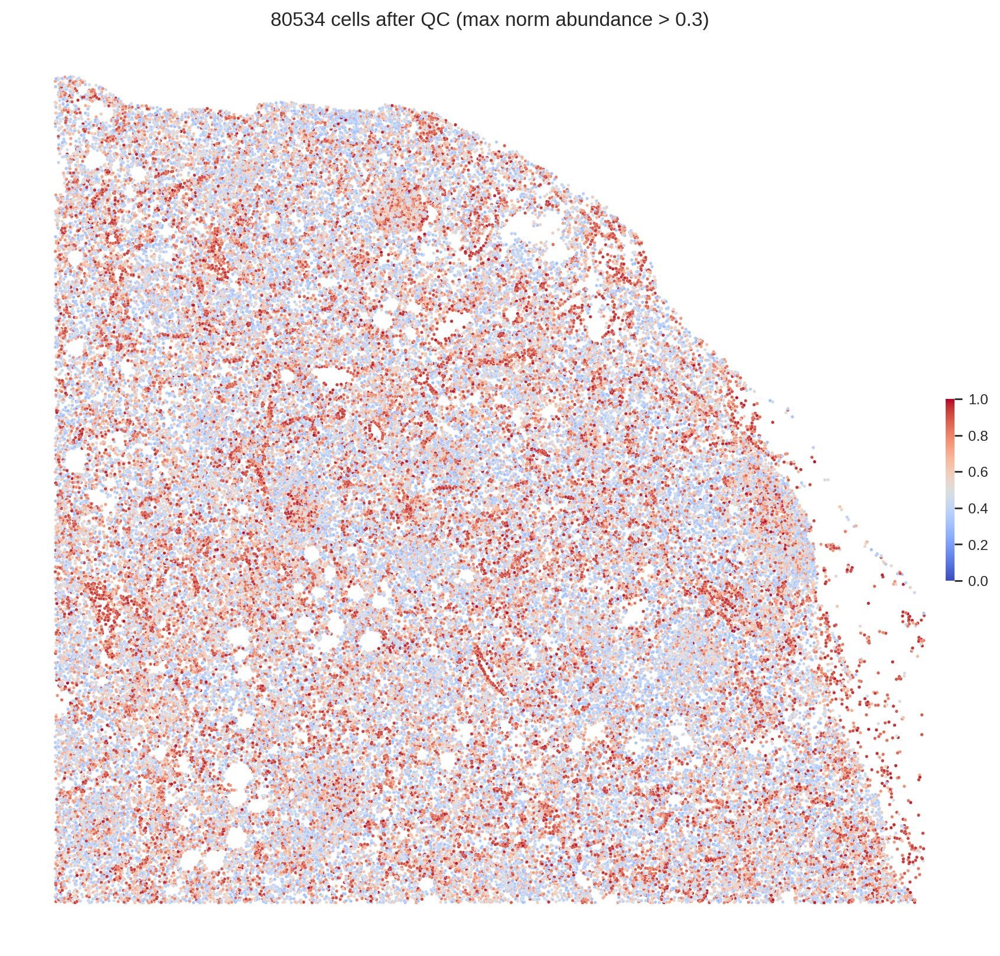

In [33]:
fig, ax = plt.subplots(1, 1, figsize=(12, 10), dpi=200)
sca_draw = crop.obs.copy()
sca = ax.scatter(sca_draw['x'].values, sca_draw['y'].values, 4, sca_draw['max_norm'].values, edgecolor='w', lw=0.1, 
           cmap=plt.cm.coolwarm, vmin=0, vmax=1)
ax.invert_yaxis()
ax.set_xticklabels([])
ax.set_yticklabels([])
for s in ['top', 'bottom', 'right', 'left']:
    ax.spines[s].set_visible(False)
cb = fig.colorbar(sca, shrink=0.2, drawedges=False, pad=-0.02)
cb.outline.set_visible(False)
ax.set_title(f'{len(sca_draw)} cells after QC (max norm abundance > {conf})', fontsize=12)
plt.axis('off')
plt.show()

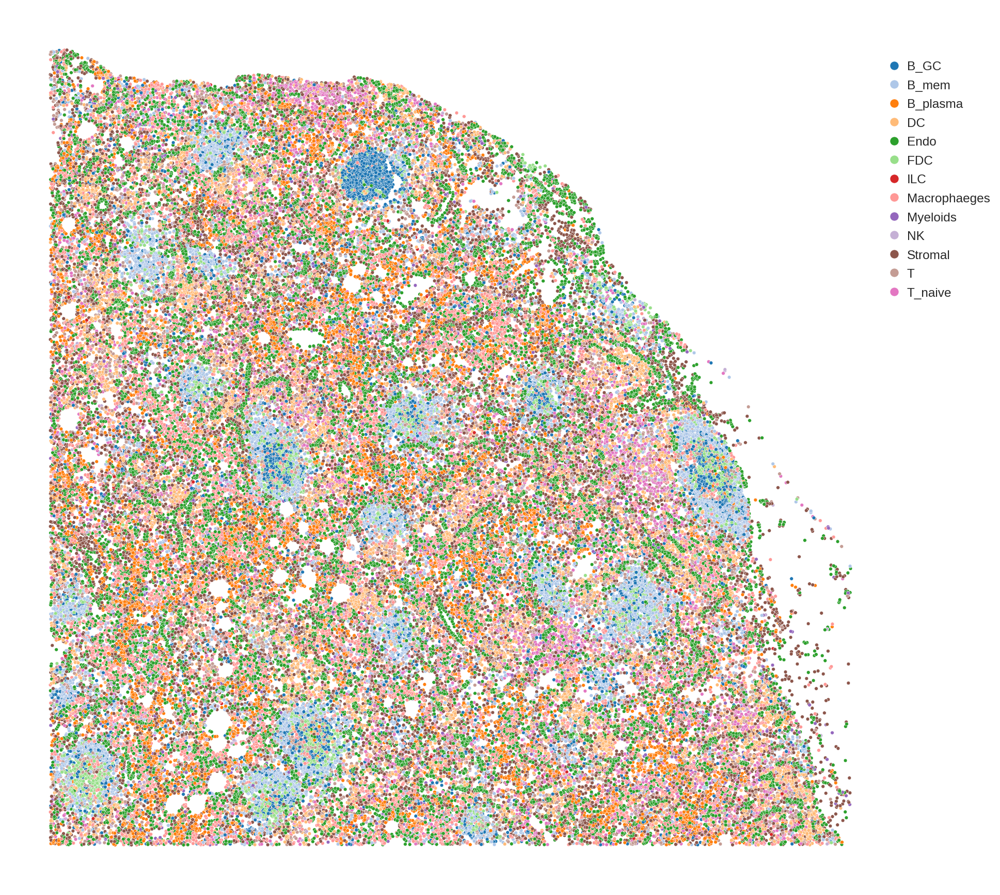

In [34]:
## all cells
plt.subplots(figsize=(11,11), dpi=200)
cts = all_cts
sns.scatterplot(data=crop.obs, x="x", y="y", hue="cell_type", hue_order=cts, s=6, palette='tab20')
plt.legend(bbox_to_anchor=(1.12,0.95), loc="upper right",framealpha=0,markerscale=2.5)
plt.axis('off')
plt.gca().invert_yaxis()
plt.show()

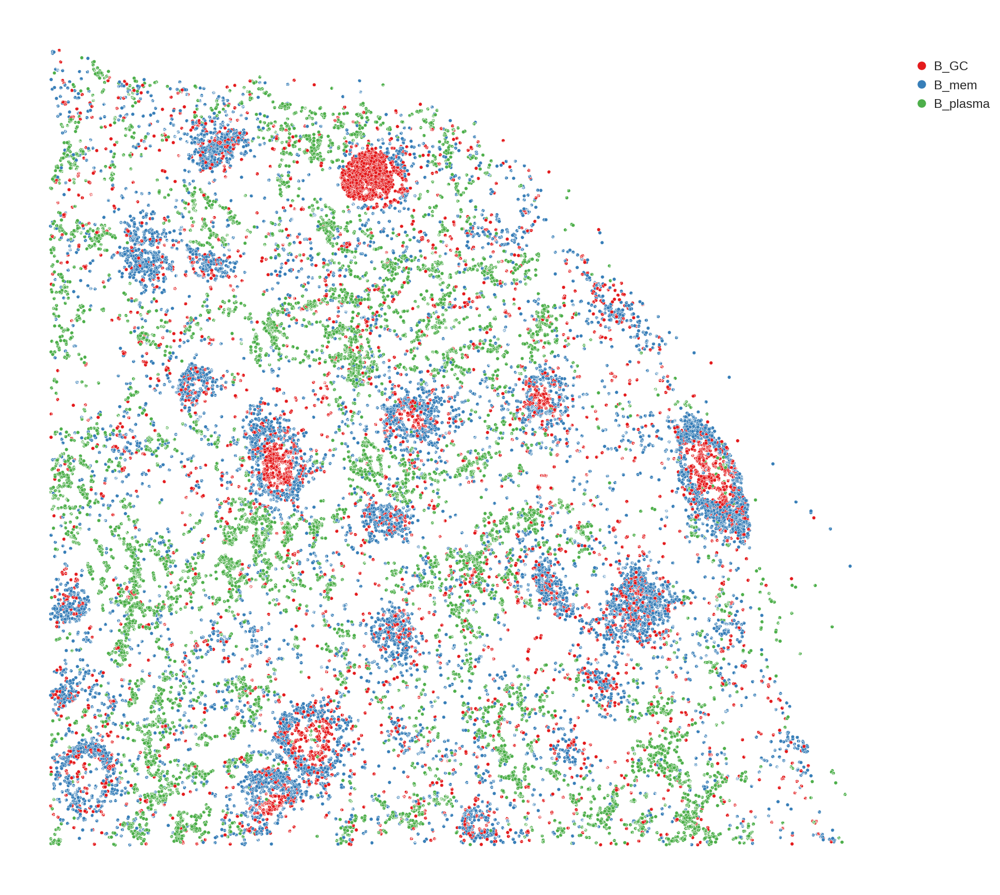

In [35]:
## B cells
plt.subplots(figsize=(11,11), dpi=200)
cts = [x for x in all_cts if x.startswith('B_')]
sns.scatterplot(data=crop.obs, x="x", y="y", hue="cell_type", hue_order=cts, s=6, palette='Set1')
plt.legend(bbox_to_anchor=(1.12,0.95), loc="upper right",framealpha=0,markerscale=2.5)
plt.axis('off')
plt.gca().invert_yaxis()
plt.show()

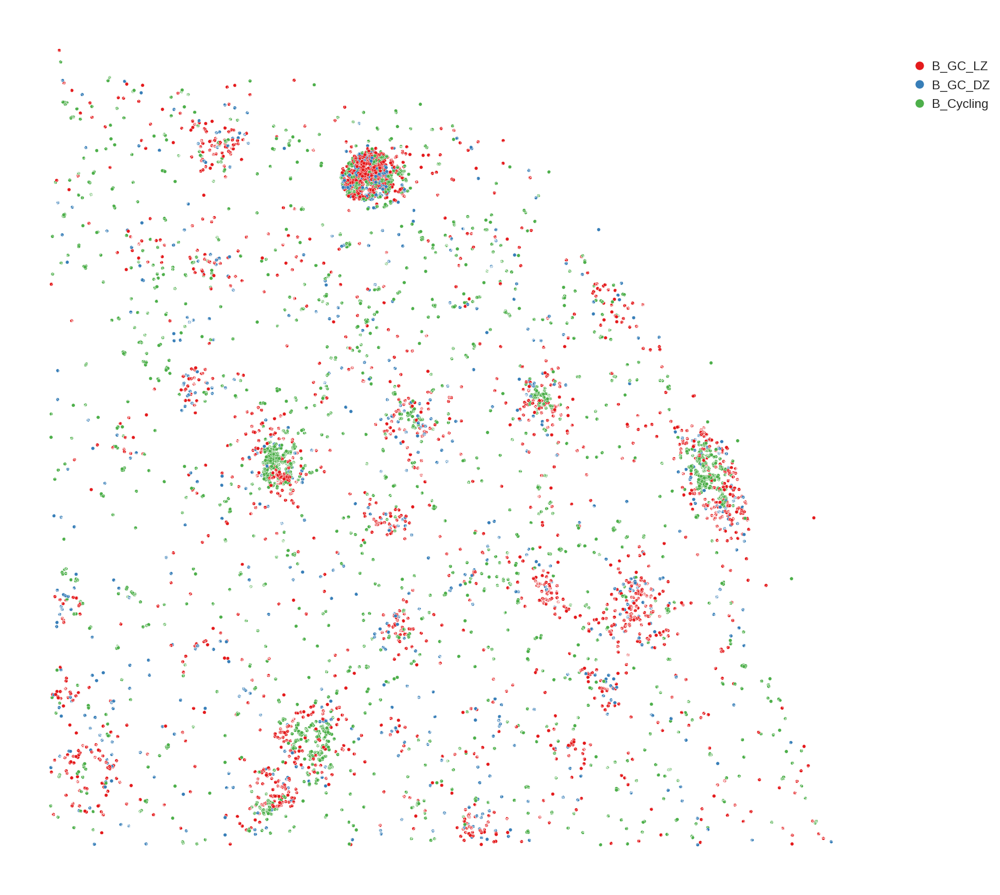

In [36]:
## T cells
plt.subplots(figsize=(11,11), dpi=200)
cts = ['B_GC_LZ', 'B_GC_DZ', 'B_Cycling']
sns.scatterplot(data=crop.obs, x="x", y="y", hue="sub_cell_type", hue_order=cts, s=6, palette='Set1')
plt.legend(bbox_to_anchor=(1.12,0.95), loc="upper right",framealpha=0,markerscale=2.5)
plt.axis('off')
plt.gca().invert_yaxis()
plt.show()

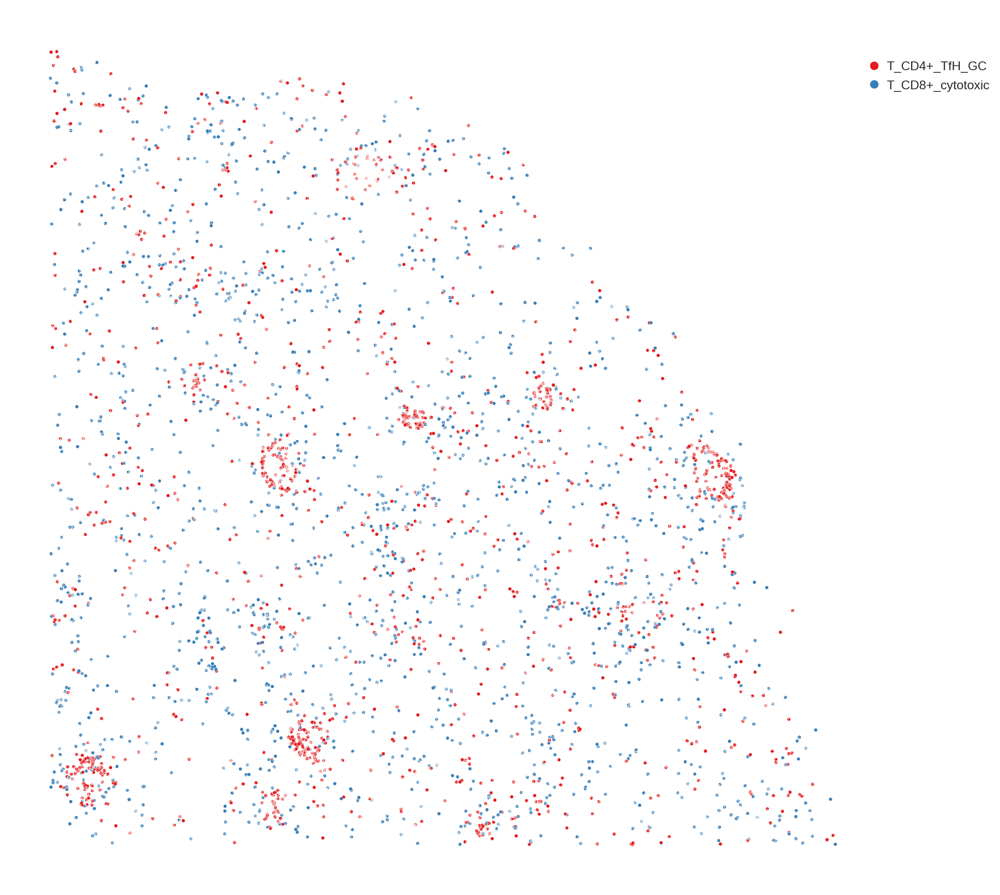

In [37]:
## T cells
plt.subplots(figsize=(11,11), dpi=200)
cts = ['T_CD4+_TfH_GC', 'T_CD8+_cytotoxic']
sns.scatterplot(data=crop.obs, x="x", y="y", hue="sub_cell_type", hue_order=cts, s=6, palette='Set1')
plt.legend(bbox_to_anchor=(1.12,0.95), loc="upper right",framealpha=0,markerscale=2.5)
plt.axis('off')
plt.gca().invert_yaxis()
plt.show()

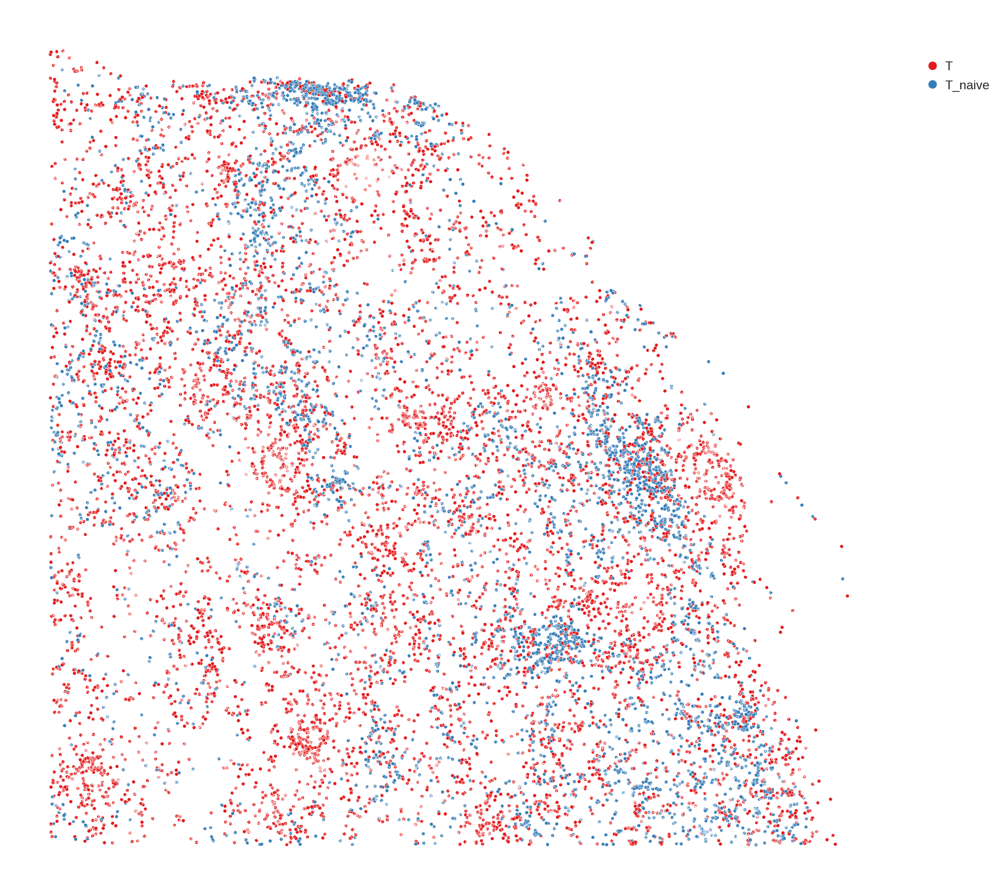

In [38]:
## T cells
plt.subplots(figsize=(11,11), dpi=200)
cts = [x for x in all_cts if x.startswith('T')]
sns.scatterplot(data=crop.obs, x="x", y="y", hue="cell_type", hue_order=cts, s=6, palette='Set1')
plt.legend(bbox_to_anchor=(1.12,0.95), loc="upper right",framealpha=0,markerscale=2.5)
plt.axis('off')
plt.gca().invert_yaxis()
plt.show()

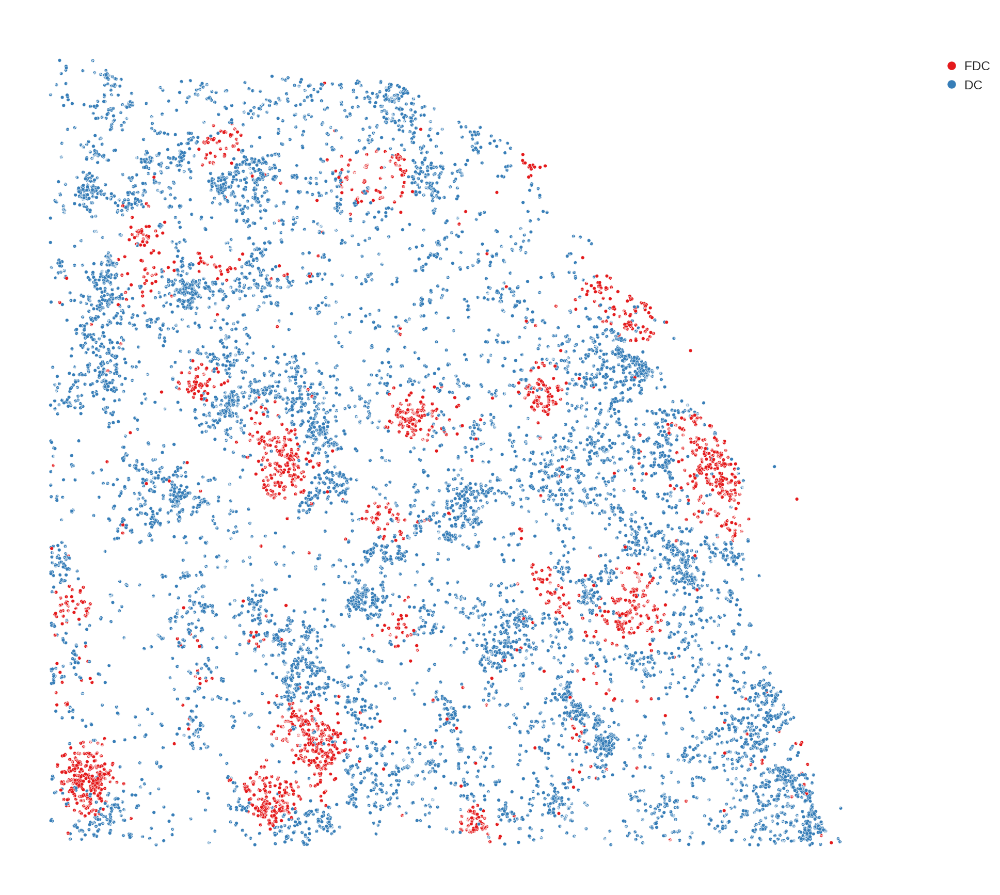

In [39]:
## DC cells
plt.subplots(figsize=(11,11), dpi=200)
cts = ['FDC', 'DC']
sns.scatterplot(data=crop.obs, x="x", y="y", hue="cell_type", hue_order=cts, s=6, palette='Set1')
plt.legend(bbox_to_anchor=(1.12,0.95), loc="upper right",framealpha=0,markerscale=2.5)
plt.axis('off')
plt.gca().invert_yaxis()
plt.show()

# Neighborhood analysis

## Delaunay

In [40]:
## spatial neighborhood graph
sq.gr.spatial_neighbors(crop, coord_type="generic", delaunay=True) # 2s
sq.gr.nhood_enrichment(crop, cluster_key="cell_type")


00%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:02<00:00, 474.71/s]

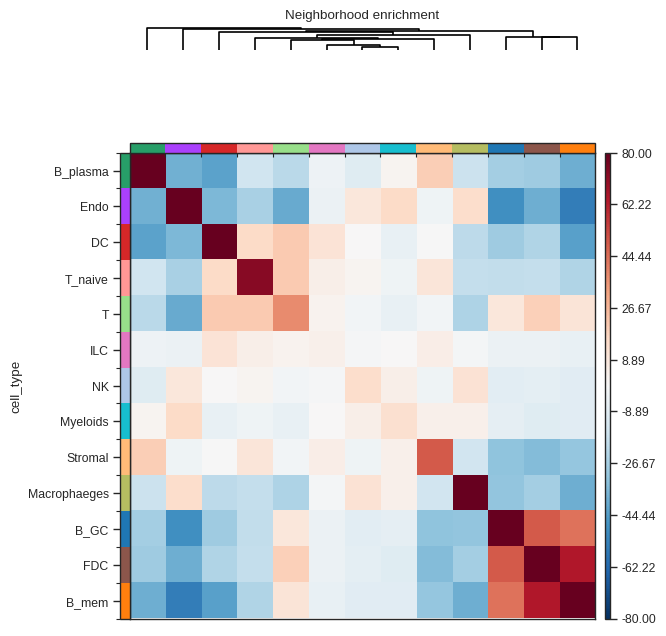

In [41]:
## delaunay
v_ = np.abs(np.array(crop.uns['cell_type_nhood_enrichment']['zscore'])).max()
sq.pl.nhood_enrichment(crop, cluster_key="cell_type", method='single', 
                       figsize=(6, 6), cmap='RdBu_r', vmin=-80, vmax=80)

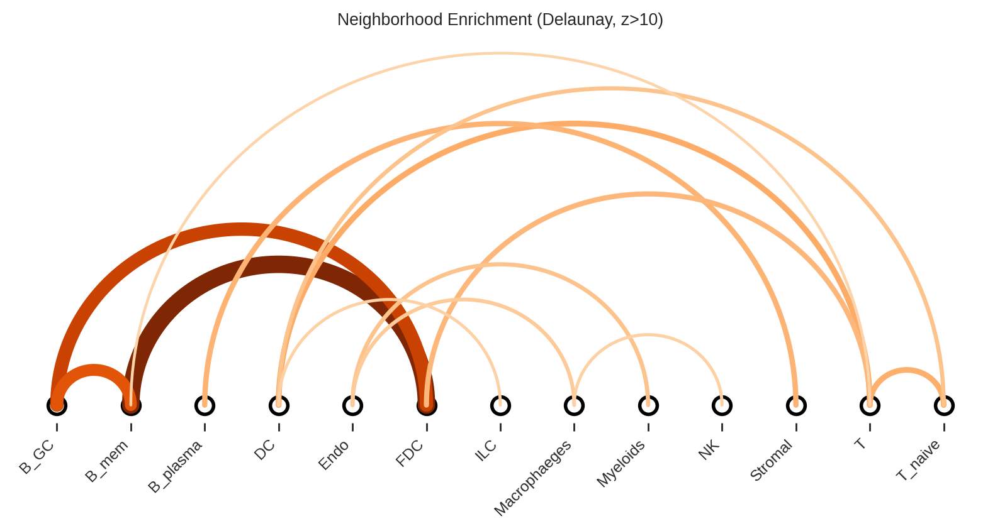

In [42]:
## enriched
nodes = list(crop.obs.cell_type.cat.categories)
groups = list(crop.obs.cell_type.cat.categories)
zscore = crop.uns['cell_type_nhood_enrichment']['zscore']
zscorel = np.tril(zscore, k=-1)
zs_thres = 10
# zs_thres = ss.norm.ppf(0.975)
binl = (zscorel > zs_thres).astype('int')
nhood_df = pd.DataFrame(columns=['from', 'to', 'weights'])
n = 0
for i in range(binl.shape[0]):
    for j in range(i):
        if binl[i,j] == 1:
            nhood_df.loc[n] = [groups[i], groups[j], zscore[i,j]]
            n += 1
nhood_df = nhood_df.sort_values('weights', ascending=False).reset_index(drop=True)
draw_arcplot(nodes, nhood_df, cmap='Oranges', figsize=(10, 4), title=f'Neighborhood Enrichment (Delaunay, z>{zs_thres})')

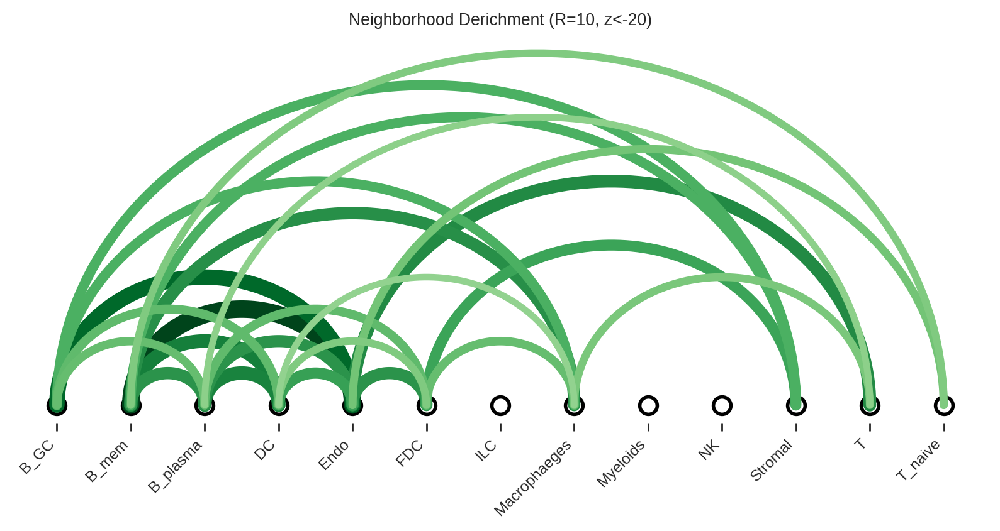

In [43]:
## deriched
nodes = list(crop.obs.cell_type.cat.categories)
groups = list(crop.obs.cell_type.cat.categories)
zscore = crop.uns['cell_type_nhood_enrichment']['zscore']
zscorel = np.tril(zscore, k=-1)
zs_thres = -20
# zs_thres = ss.norm.ppf(0.975)
binl = (zscorel < zs_thres).astype('int')
nhood_df = pd.DataFrame(columns=['from', 'to', 'weights'])
n = 0
for i in range(binl.shape[0]):
    for j in range(i):
        if binl[i,j] == 1:
            nhood_df.loc[n] = [groups[i], groups[j], abs(zscore[i,j])]
            n += 1
nhood_df = nhood_df.sort_values('weights', ascending=False).reset_index(drop=True)
draw_arcplot(nodes, nhood_df, cmap='Greens', figsize=(10, 4), title=f'Neighborhood Derichment (R=10, z<{zs_thres})')

## R=10

In [44]:
## spatial neighborhood graph
sq.gr.spatial_neighbors(crop, coord_type="generic", radius=10)
sq.gr.nhood_enrichment(crop, cluster_key="cell_type")


00%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:02<00:00, 497.86/s]

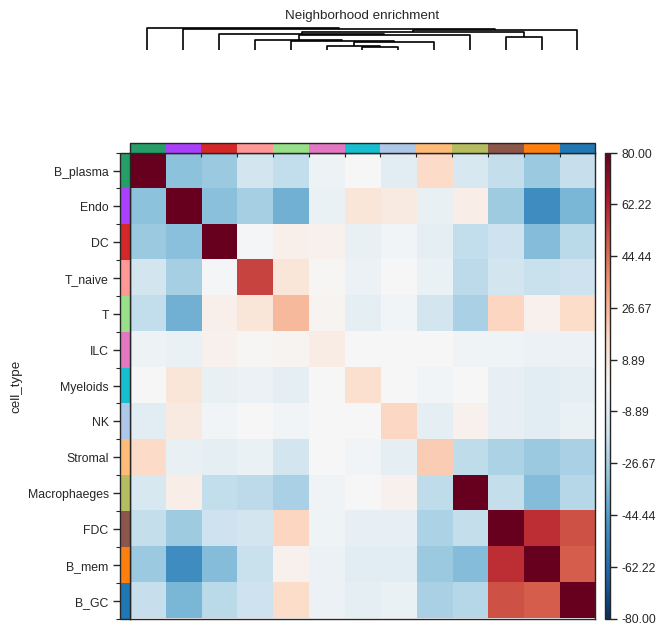

In [45]:
## radius=10
v_ = np.abs(np.array(crop.uns['cell_type_nhood_enrichment']['zscore'])).max()
sq.pl.nhood_enrichment(crop, cluster_key="cell_type", method='single', 
                       figsize=(6, 6), cmap='RdBu_r', vmin=-80, vmax=80)

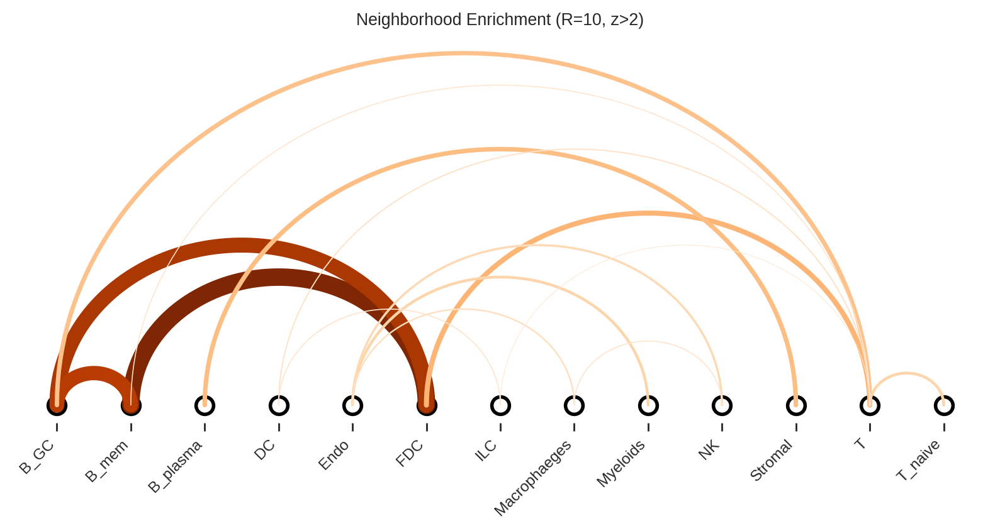

In [46]:
## enriched
nodes = list(crop.obs.cell_type.cat.categories)
groups = list(crop.obs.cell_type.cat.categories)
zscore = crop.uns['cell_type_nhood_enrichment']['zscore']
zscorel = np.tril(zscore, k=-1)
zs_thres = 2
# zs_thres = ss.norm.ppf(0.975)
binl = (zscorel > zs_thres).astype('int')
nhood_df = pd.DataFrame(columns=['from', 'to', 'weights'])
n = 0
for i in range(binl.shape[0]):
    for j in range(i):
        if binl[i,j] == 1:
            nhood_df.loc[n] = [groups[i], groups[j], zscore[i,j]]
            n += 1
nhood_df = nhood_df.sort_values('weights', ascending=False).reset_index(drop=True)
draw_arcplot(nodes, nhood_df, cmap='Oranges', figsize=(10, 4), title=f'Neighborhood Enrichment (R=10, z>{zs_thres})')

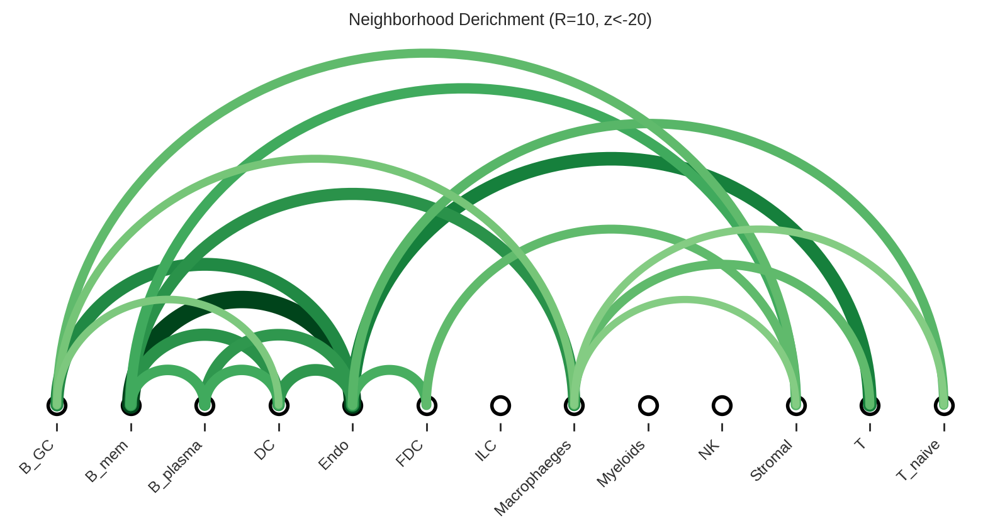

In [47]:
## deriched
nodes = list(crop.obs.cell_type.cat.categories)
groups = list(crop.obs.cell_type.cat.categories)
zscore = crop.uns['cell_type_nhood_enrichment']['zscore']
zscorel = np.tril(zscore, k=-1)
zs_thres = -20
# zs_thres = ss.norm.ppf(0.975)
binl = (zscorel < zs_thres).astype('int')
nhood_df = pd.DataFrame(columns=['from', 'to', 'weights'])
n = 0
for i in range(binl.shape[0]):
    for j in range(i):
        if binl[i,j] == 1:
            nhood_df.loc[n] = [groups[i], groups[j], abs(zscore[i,j])]
            n += 1
nhood_df = nhood_df.sort_values('weights', ascending=False).reset_index(drop=True)
draw_arcplot(nodes, nhood_df, cmap='Greens', figsize=(10, 4), title=f'Neighborhood Derichment (R=10, z<{zs_thres})')

## R=20

In [48]:
## spatial neighborhood graph
sq.gr.spatial_neighbors(crop, coord_type="generic", radius=20)
sq.gr.nhood_enrichment(crop, cluster_key="cell_type")


00%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:02<00:00, 424.08/s]

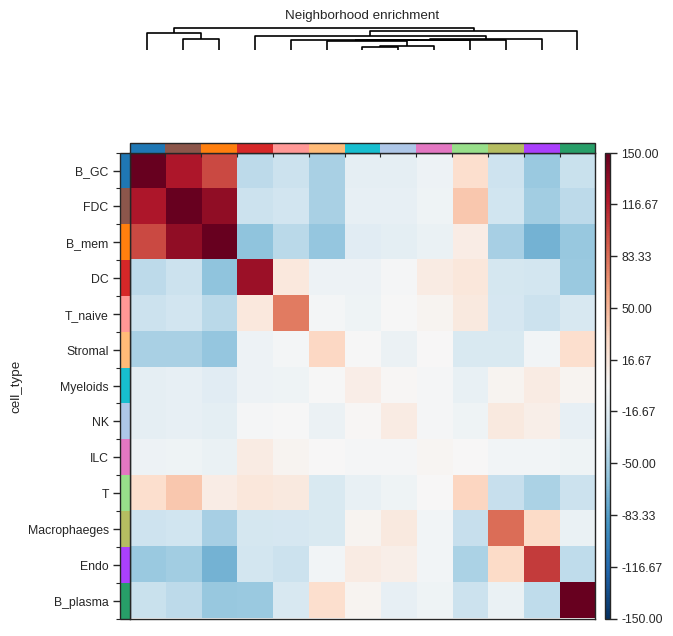

In [49]:
## radius=20
v_ = np.abs(np.array(crop.uns['cell_type_nhood_enrichment']['zscore'])).max()
sq.pl.nhood_enrichment(crop, cluster_key="cell_type", method='single', 
                       figsize=(6, 6), cmap='RdBu_r', vmin=-150, vmax=150)

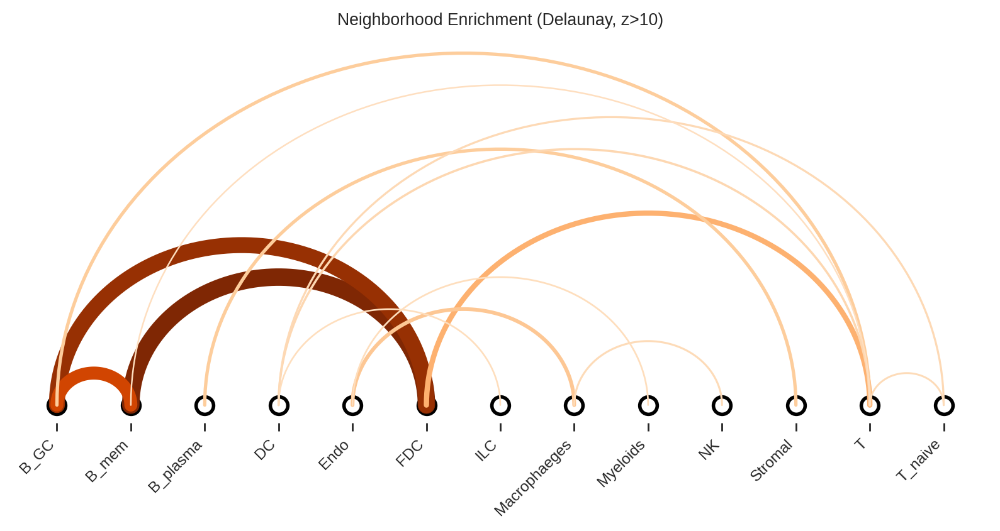

In [50]:
## enriched
nodes = list(crop.obs.cell_type.cat.categories)
groups = list(crop.obs.cell_type.cat.categories)
zscore = crop.uns['cell_type_nhood_enrichment']['zscore']
zscorel = np.tril(zscore, k=-1)
zs_thres = 10
# zs_thres = ss.norm.ppf(0.975)
binl = (zscorel > zs_thres).astype('int')
nhood_df = pd.DataFrame(columns=['from', 'to', 'weights'])
n = 0
for i in range(binl.shape[0]):
    for j in range(i):
        if binl[i,j] == 1:
            nhood_df.loc[n] = [groups[i], groups[j], zscore[i,j]]
            n += 1
nhood_df = nhood_df.sort_values('weights', ascending=False).reset_index(drop=True)
draw_arcplot(nodes, nhood_df, cmap='Oranges', figsize=(10, 4), title=f'Neighborhood Enrichment (Delaunay, z>{zs_thres})')

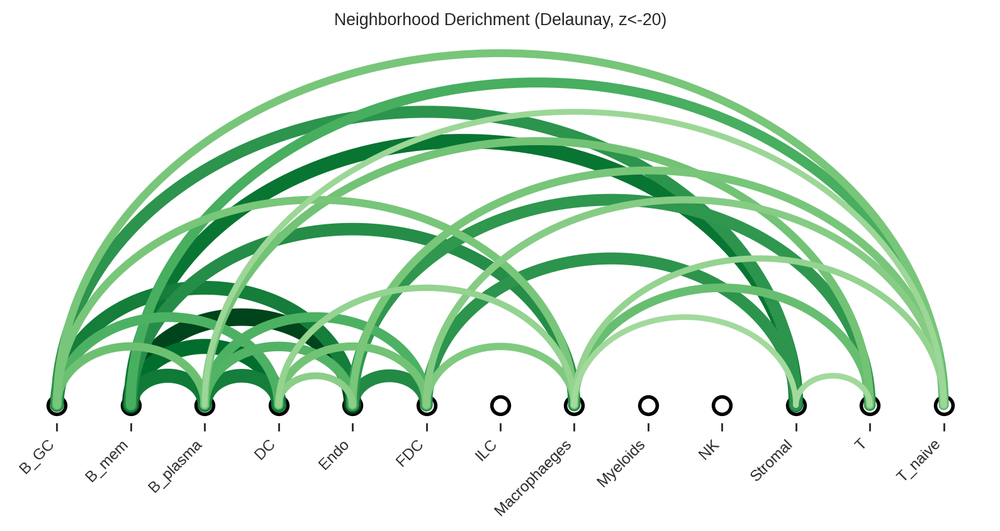

In [51]:
## deriched
nodes = list(crop.obs.cell_type.cat.categories)
groups = list(crop.obs.cell_type.cat.categories)
zscore = crop.uns['cell_type_nhood_enrichment']['zscore']
zscorel = np.tril(zscore, k=-1)
zs_thres = -20
# zs_thres = ss.norm.ppf(0.975)
binl = (zscorel < zs_thres).astype('int')
nhood_df = pd.DataFrame(columns=['from', 'to', 'weights'])
n = 0
for i in range(binl.shape[0]):
    for j in range(i):
        if binl[i,j] == 1:
            nhood_df.loc[n] = [groups[i], groups[j], abs(zscore[i,j])]
            n += 1
nhood_df = nhood_df.sort_values('weights', ascending=False).reset_index(drop=True)
draw_arcplot(nodes, nhood_df, cmap='Greens', figsize=(10, 4), title=f'Neighborhood Derichment (Delaunay, z<{zs_thres})')

# Result

In [52]:
save_dir = f"/data2/xiaojiashun/niche/result/Xenium/lymph-trans-label-3crop/subct_conf{str(conf).replace('.','')}"
save_dir

'/data2/xiaojiashun/niche/result/Xenium/lymph-trans-label-3crop/subct_conf03'

## T

In [53]:
## run method
target_ct = 'T'
target_ct_abbr = target_ct
use_cov_test_genes = True
udf, vdf, meta = run_method(crop, target_ct,  target_ct_abbr, self=True,
                       sigma=20, cutoff=0.05, sort_comp_by_corr=False,
                       n_hvg=3000, cov_thres=0.05, cov_test_null=True,
                       use_cov_test_genes=use_cov_test_genes,
                       cca_comp=10, px=0.6, pz=0.4)

***** Niche matrix *****
13 cell_types.
num_cell_ID: (80534, 13).
Use other 13 cell types.
7129 T, 80534 cells in total.

***** Cov test *****
sparkx_X: (2995, 7129); sparkx_N: (7129, 13)
2994 / 2995 genes have pvalue.
Cov test on permuted data...
427 genes with p_adj < 0.05.
Use all 427 genes with p_adj < 0.05.

***** CCA *****
cca_X: (7129, 427); cca_N: (7129, 13)
Nonneg CCA cors: [0.718 0.426 0.444 0.521 0.409 0.383 0.251 0.336 0.199 0.208]
udf: (427, 10); vdf: (13, 10).

T: Finished in 20.2s.


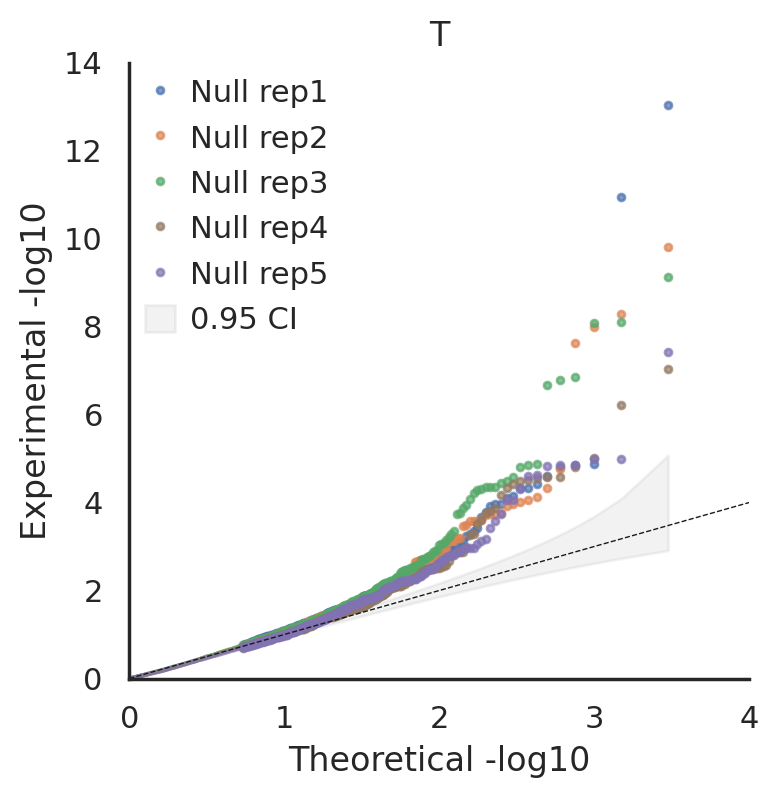

In [54]:
## qqplot: null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=200)
qqplot(meta['cov_test_qqplot_data'][1:], [f'Null rep{i}' for i in range(1,6)], 
       color=['C0', 'C1', 'C2', 'C5', 'C4'], shape=['.','.','.','.','.'], distribution='beta', ax=ax, title=target_ct)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

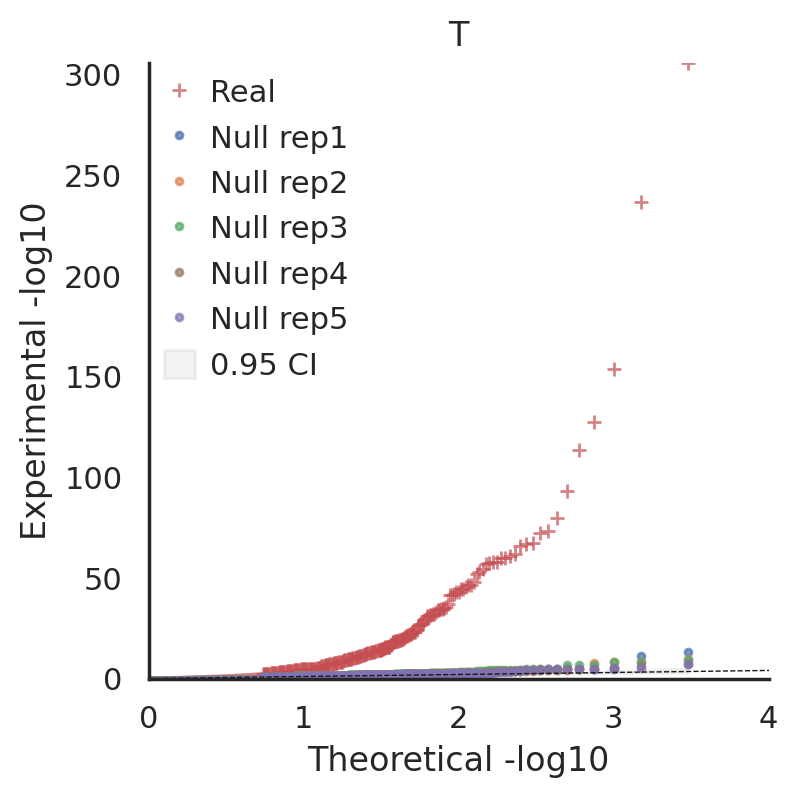

In [55]:
## qqplot: real and null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=200)
qqplot(meta['cov_test_qqplot_data'], ['Real']+[f'Null rep{i}' for i in range(1,6)], 
       color=['C3', 'C0', 'C1', 'C2', 'C5', 'C4'], shape=['+','.','.','.','.','.'], distribution='beta', ax=ax, title=target_ct)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

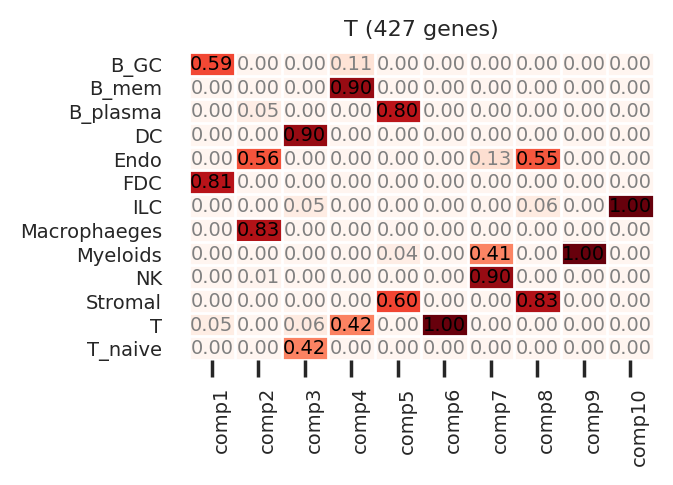

In [56]:
## v heatmap
sns.set_theme(style="white")
draw_v_heatmap(vdf, figsize=(3,2), title=f'{target_ct} ({len(udf)} genes)')

In [57]:
## select comps
draw_comps = [1,2,3,4]

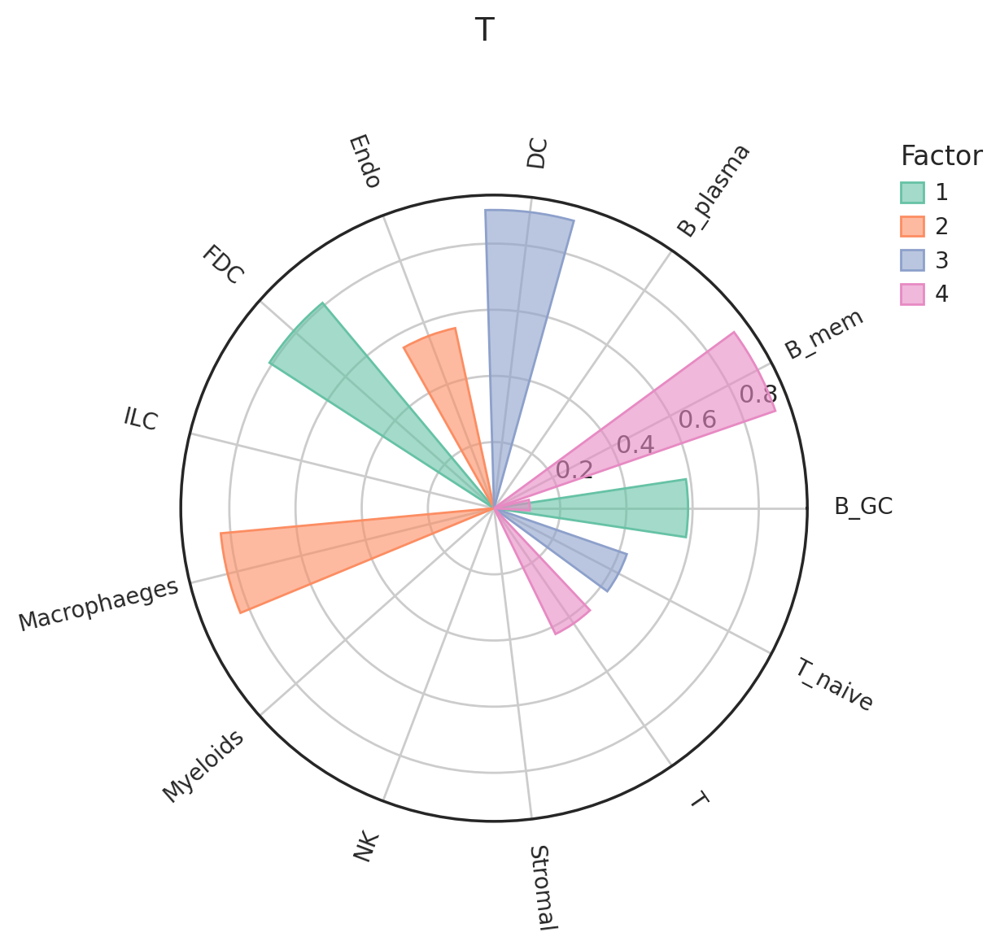

In [58]:
## v circular
sns.set_theme(style='white')
draw_v_circular(vdf, draw_comps, v_thres=0.1, cmap=mpl.colormaps['Set2'], figsize=(5,5), dpi=200, title=target_ct)

In [59]:
## niche scores
XY_loc_df = compute_score(crop, udf, vdf, target_ct, meta['N_target'], meta['loc_target'], meta['use_group_ids'])

Computed niche-related scores: XY_loc_df (7129, 461).


In [240]:
## save result
save_objs = {'udf': udf,
             'vdf': vdf,
             'meta': meta,
             'XY_loc_df': XY_loc_df}
filename = f'crop{crop_id}_{target_ct}.pkl'
with open(f'{save_dir}/{filename}', 'wb') as f:
    pickle.dump(save_objs, f)

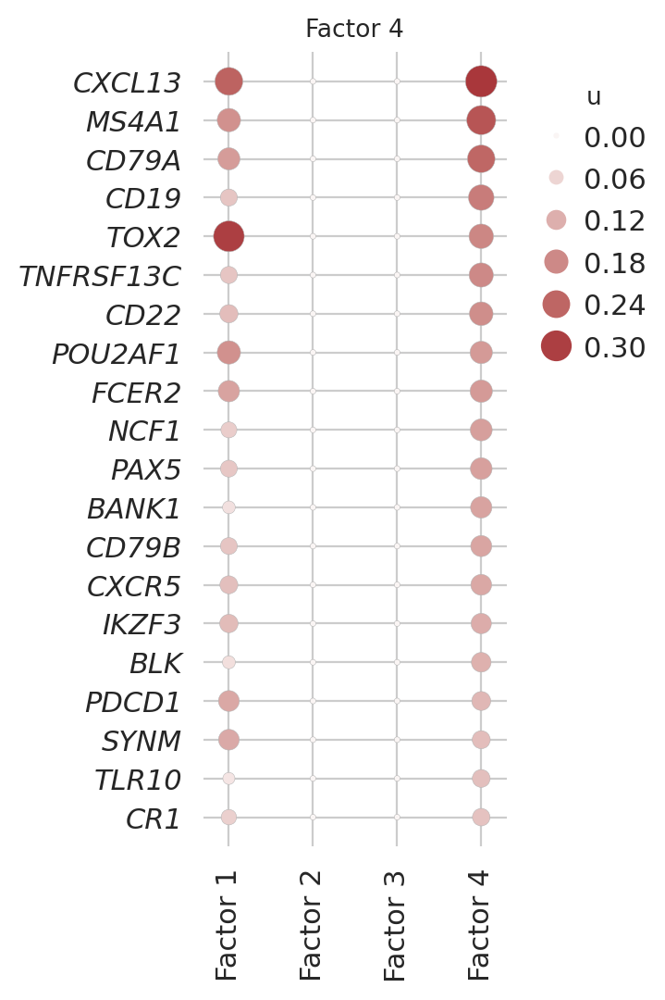

In [82]:
## u dotmap
focus_comp = 4
n_top_gene = 20
h = 0.25 * n_top_gene
u_title = f"Factor {draw_comps.index(focus_comp)+1}"
xticklabels = [f"Factor {x}" for x in draw_comps]
draw_u_dotmap(udf, focus_comp, draw_comps, n_top_gene, (5, 150), xticklabels,
                fs=11, h=h, w=3, title=u_title, mx=0.1, my=0.04, leg_pos=(1.1,0.95), dpi=200)

In [69]:
## kde diff: concord
kde_comp = 4
t0 = time.time()
Z, lims, draw_ids = kde_diff(XY_loc_df, kde_comp, score='concord', z_quantile=0.99, bw=20)
print(f'KDE diff: {time.time() - t0:.1f}s')

KDE diff: 64.2s


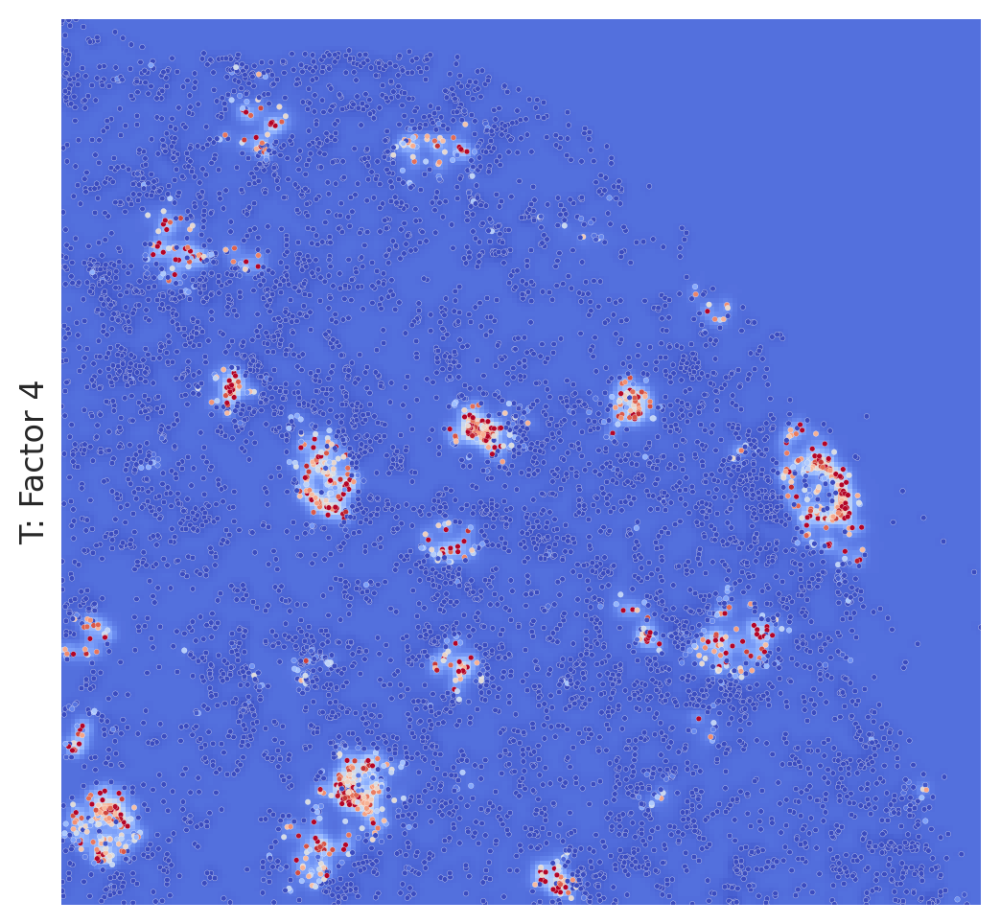

In [70]:
## kde diff: concord
draw_kde_diff(XY_loc_df, kde_comp, target_ct, Z, lims, draw_ids, score='concord',
                  use_quant=0.99, draw_points=True, cmap=mpl.colormaps['coolwarm'], 
                  ylabel=f'{target_ct}: Factor {draw_comps.index(kde_comp)+1}', fs=12, title=None, figsize=(7, 6), dpi=200)

In [77]:
## sub cell type count of one factor
subct_comp = 4
score_df = XY_loc_df.copy()
subcts = [x for x in score_df.sub_cell_type.unique() if x.startswith('T')]
count_df = sub_ct_enrich(subct_comp, score_df, subcts, score='concord', q1=0.9, q2=0.95)
count_df

,base,obs_high_09,obs_high_095,exp_high_09,exp_high_095,fold_09,fold_095
sub_cell_type,,,,,,,
T_CD4+_TfH_GC,1373,415,204,137,68,3.029197,3.000000
T_CD8+_cytotoxic,1716,163,92,171,85,0.953216,1.082353
T_TfR,608,38,19,60,30,0.633333,0.633333
T_Treg,1389,37,20,138,69,0.268116,0.289855
T_TIM3+,1927,60,22,192,96,0.312500,0.229167
T_CD4+,116,0,0,11,5,0.000000,0.000000


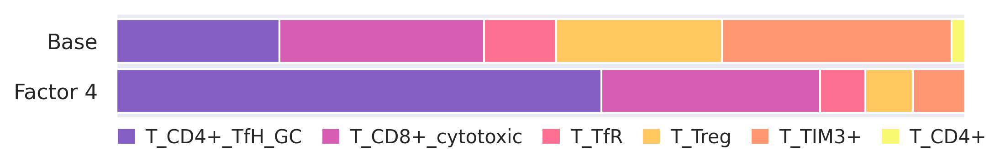

In [78]:
## sub cell type proportion of this factor
sns.set_theme(style="darkgrid")
# colors = mpl.colormaps['Set2'].colors
color_map = {'T_CD4+_TfH_GC': '#845ec2',
             'T_CD8+_cytotoxic': '#d65db1',
             'T_TfR': '#ff6f91',
             'T_TIM3+': '#ff9671',
             'T_Treg': '#ffc75f',
             'T_CD4+': '#f9f871'}
colors = [color_map[k] for k in count_df.index.tolist()]
draw_sub_ct_prop(count_df, alphabet=False, figsize=(8,1), dpi=300, h=0.35, yticks=[0, 0.4], 
                     yticklabels=['Base', f'Factor {subct_comp}'], colors=colors, ylim=(-0.22,0.62))

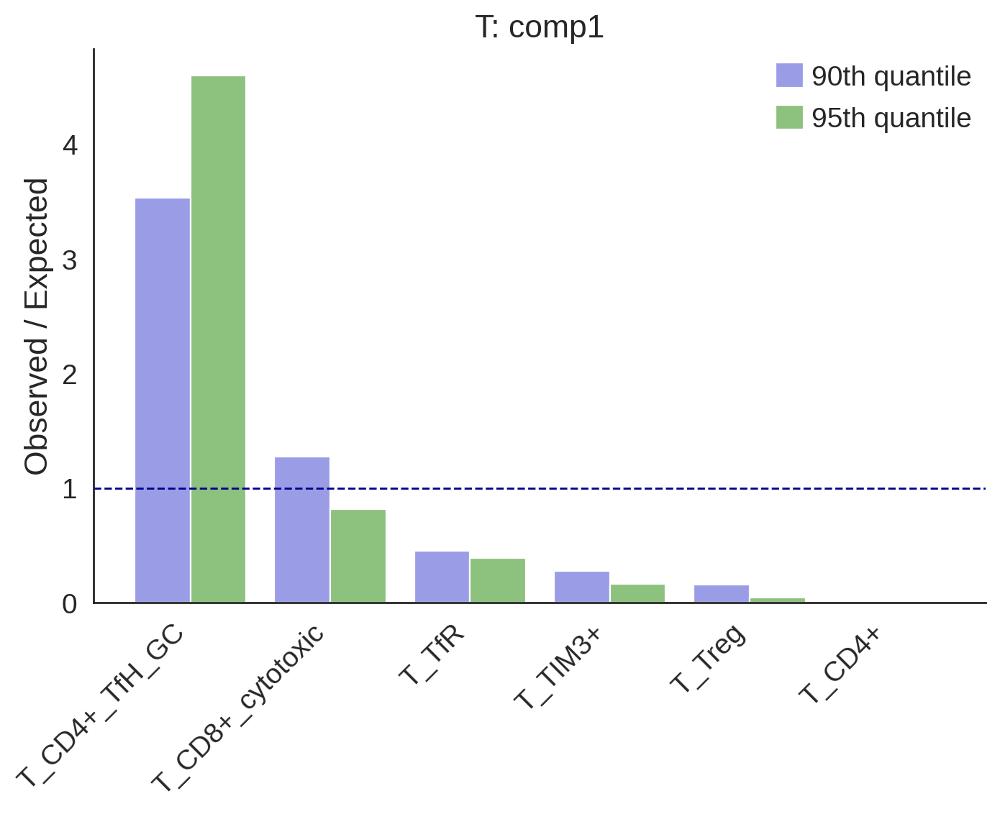

In [274]:
## enrichment folds
draw_sub_ct_enrich(count_df, figsize=(8,5), dpi=200, fs=14, width=0.4, alpha=1, title=None)

In [61]:
## combine go results
# u_thres, u_top = [0.05, 0.05, 0.05, 0.05], None
u_thres, u_top = None, 15
wdf12 = go_combine(udf, vdf, draw_comps, u_thres=u_thres, u_top=u_top, pval_thres=0.05, n_top=15, enrichr_cutoff=0.1)
print(wdf12['-log10_padj'].min(),round(wdf12['-log10_padj'].max(),1),wdf12['num_gene'].min(),round(wdf12['num_gene'].max(),1))

1 ['B_GC', 'FDC'] 15 15
2 ['Endo', 'Macrophaeges'] 15 15
3 ['DC', 'T_naive'] 15 15
4 ['B_mem', 'T'] 15 15
0.0 4.6 0.0 5.0


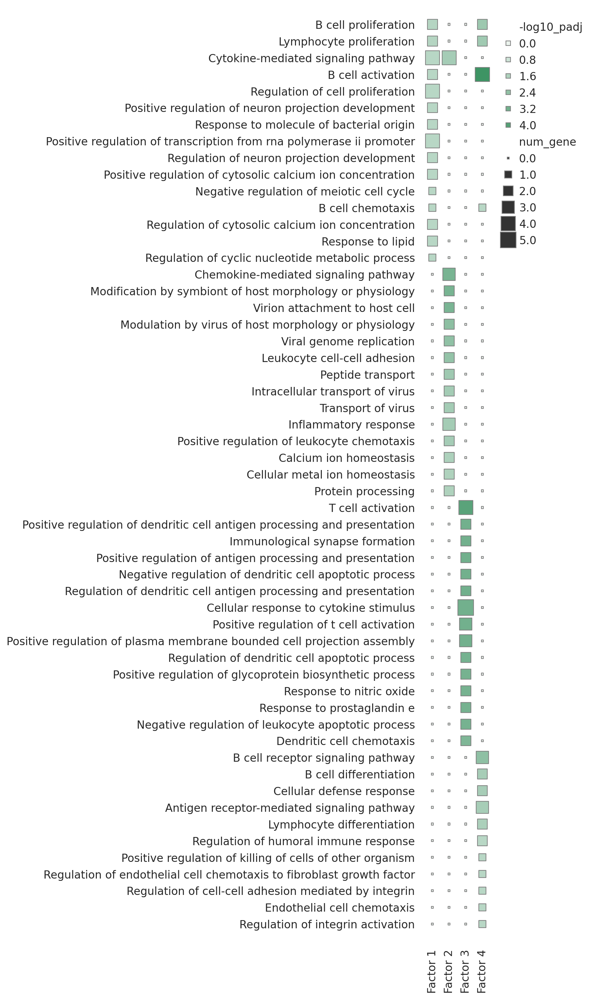

In [62]:
## draw combined go results
draw_go_combine(wdf12, draw_comps, dpi=200, sizes=(5,300), height=15,
                hue_norm=(0,np.ceil(wdf12['-log10_padj'].max())), 
                size_norm=(0,wdf12['num_gene'].max()),
                fs=12, mx=0.2, my=0.02, leg_pos=(0.76,0.98), title=None)

In [166]:
## ora
ora_comp = 'comp3'
ora_u_thres = 0.1
clist = vdf.loc[vdf[ora_comp] > 0.2].index.tolist()
print(clist)
glist = udf.loc[udf[ora_comp] > ora_u_thres].index.tolist()
glist = udf.sort_values(ora_comp, ascending=False).iloc[:10].index.tolist()
print(len(glist))
enr_res = gseapy.enrichr(gene_list=glist,organism='Human',gene_sets=['GO_Biological_Process_2018'],cutoff = 0.1)
enr_res.res2d.loc[enr_res.res2d['Adjusted P-value']<0.05,['Term','Overlap','P-value','Adjusted P-value','Genes']]

['DC', 'T_naive']
10


,Term,Overlap,P-value,Adjusted P-value,Genes
0,cellular response to cytokine stimulus (GO:007...,7/456,3.460478e-10,9.343292e-08,CCL22;LEF1;S1PR1;FLT3LG;CCR7;CCL19;CCL17
1,monocyte chemotaxis (GO:0002548),3/41,9.499260e-07,7.585457e-05,CCL22;CCL19;CCL17
2,lymphocyte chemotaxis (GO:0048247),3/44,1.179263e-06,7.585457e-05,CCL22;CCL19;CCL17
3,positive regulation of GTPase activity (GO:004...,4/192,1.652276e-06,7.585457e-05,CCL22;CCR7;CCL19;CCL17
4,chemokine-mediated signaling pathway (GO:0070098),3/52,1.963692e-06,7.585457e-05,CCL22;CCL19;CCL17
5,positive regulation of ERK1 and ERK2 cascade (...,4/201,1.983051e-06,7.585457e-05,CCL22;CCR7;CCL19;CCL17
6,neutrophil chemotaxis (GO:0030593),3/53,2.080968e-06,7.585457e-05,CCL22;CCL19;CCL17
7,granulocyte chemotaxis (GO:0071621),3/56,2.460474e-06,7.585457e-05,CCL22;CCL19;CCL17
8,neutrophil migration (GO:1990266),3/58,2.737395e-06,7.585457e-05,CCL22;CCL19;CCL17
9,positive regulation of dendritic cell antigen ...,2/6,3.371314e-06,7.585457e-05,CCR7;CCL19


<Axes: title={'center': 'T: comp1 (u > 0.05)'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

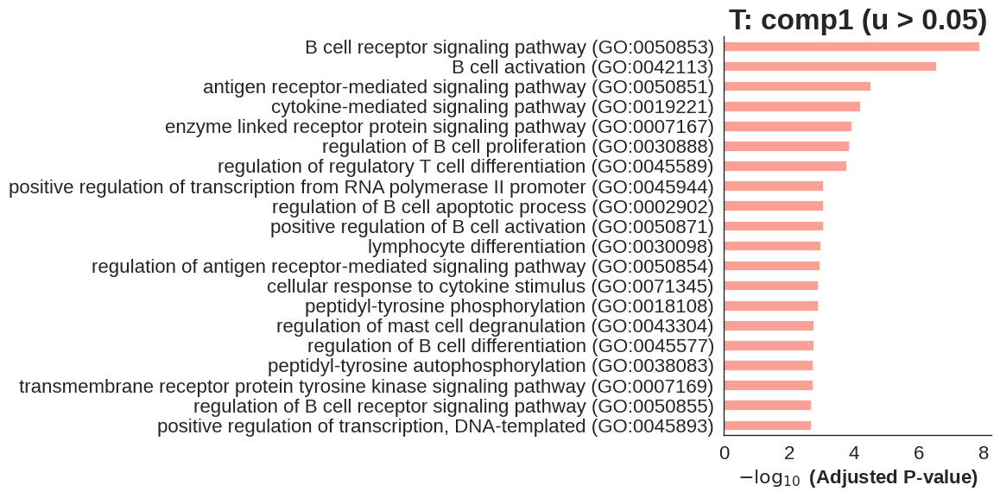

In [97]:
gseapy.barplot(enr_res.res2d,title=f'{target_ct}: {ora_comp} (u > {ora_u_thres})', top_term=20, cutoff=0.05)

## B_mem

In [83]:
## run method
target_ct = 'B_mem'
target_ct_abbr = target_ct
use_cov_test_genes = True
udf, vdf, meta = run_method(crop, target_ct,  target_ct_abbr, self=True,
                       sigma=20, cutoff=0.05, sort_comp_by_corr=False,
                       n_hvg=3000, cov_thres=0.05, cov_test_null=True,
                       use_cov_test_genes=use_cov_test_genes,
                       cca_comp=10, px=0.6, pz=0.4)

***** Niche matrix *****
13 cell_types.
num_cell_ID: (80534, 13).
Use other 13 cell types.
8135 B_mem, 80534 cells in total.

***** Cov test *****
sparkx_X: (2996, 8135); sparkx_N: (8135, 13)
2995 / 2996 genes have pvalue.
Cov test on permuted data...
345 genes with p_adj < 0.05.
Use all 345 genes with p_adj < 0.05.

***** CCA *****
cca_X: (8135, 345); cca_N: (8135, 13)
Nonneg CCA cors: [0.546 0.559 0.492 0.418 0.314 0.391 0.315 0.393 0.39  0.217]
udf: (345, 10); vdf: (13, 10).

B_mem: Finished in 22.0s.


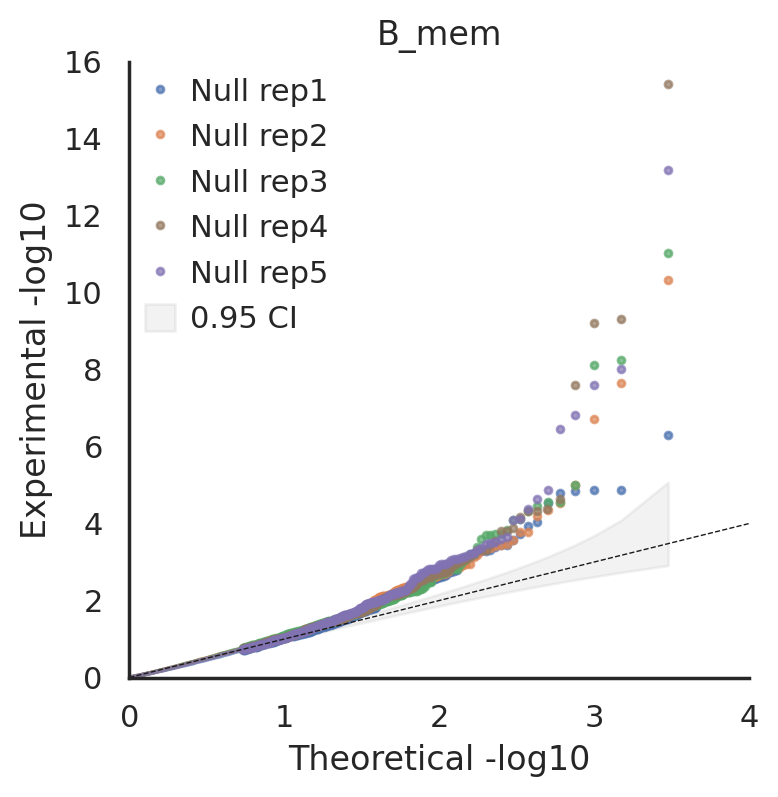

In [84]:
## qqplot: null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=200)
qqplot(meta['cov_test_qqplot_data'][1:], [f'Null rep{i}' for i in range(1,6)], 
       color=['C0', 'C1', 'C2', 'C5', 'C4'], shape=['.','.','.','.','.'], distribution='beta', ax=ax, title=target_ct)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

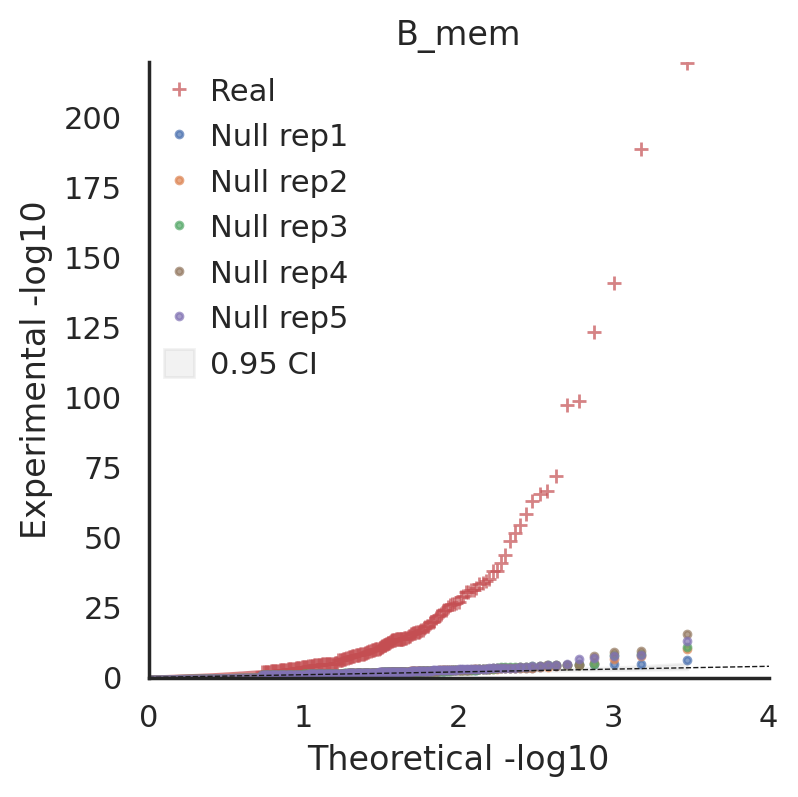

In [85]:
## qqplot: real and null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=200)
qqplot(meta['cov_test_qqplot_data'], ['Real']+[f'Null rep{i}' for i in range(1,6)], 
       color=['C3', 'C0', 'C1', 'C2', 'C5', 'C4'], shape=['+','.','.','.','.','.'], distribution='beta', ax=ax, title=target_ct)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

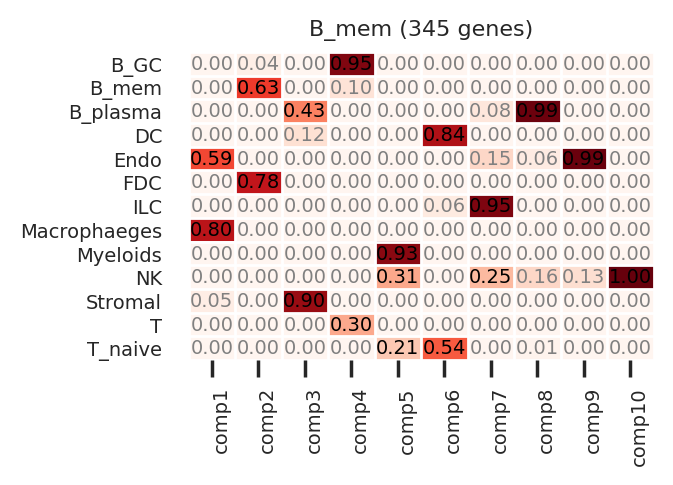

In [86]:
## v heatmap
sns.set_theme(style="white")
draw_v_heatmap(vdf, figsize=(3,2), title=f'{target_ct} ({len(udf)} genes)')

In [87]:
## select comps
draw_comps = [1,2,4,6]

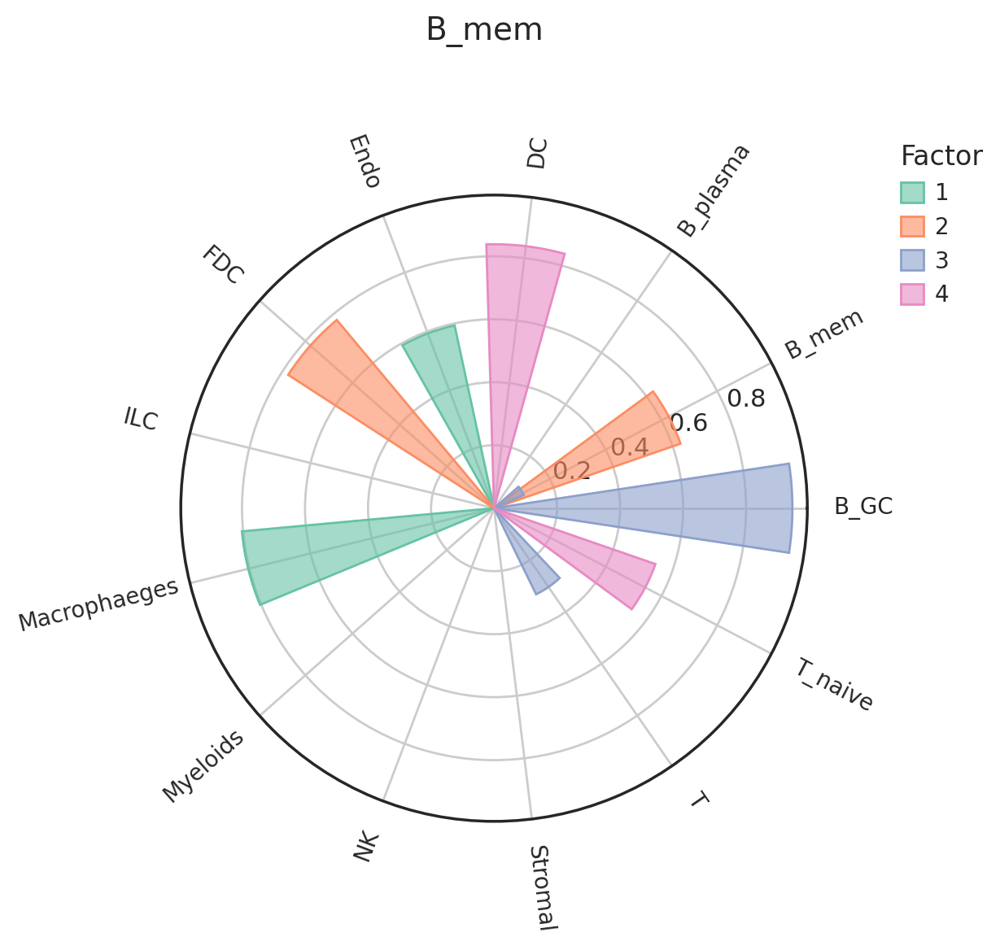

In [88]:
## v circular
sns.set_theme(style='white')
draw_v_circular(vdf, draw_comps, v_thres=0.1, cmap=mpl.colormaps['Set2'], figsize=(5,5), dpi=200, title=target_ct)

In [89]:
## niche scores
XY_loc_df = compute_score(crop, udf, vdf, target_ct, meta['N_target'], meta['loc_target'], meta['use_group_ids'])

Computed niche-related scores: XY_loc_df (8135, 379).


In [370]:
## save result
save_objs = {'udf': udf,
             'vdf': vdf,
             'meta': meta,
             'XY_loc_df': XY_loc_df}
filename = f'crop{crop_id}_{target_ct}.pkl'
with open(f'{save_dir}/{filename}', 'wb') as f:
    pickle.dump(save_objs, f)

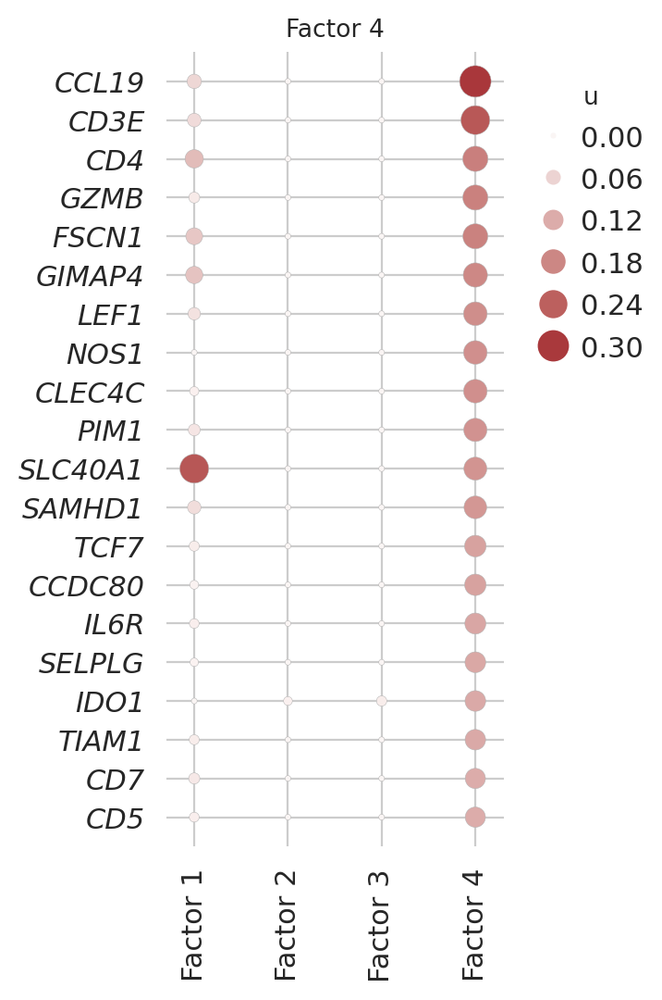

In [105]:
## u dotmap
focus_comp = 6
n_top_gene = 20
h = 0.25 * n_top_gene
u_title = f"Factor {draw_comps.index(focus_comp)+1}"
xticklabels = [f"Factor {x}" for x in range(1,len(draw_comps)+1)]
draw_u_dotmap(udf, focus_comp, draw_comps, n_top_gene, (5, 150), xticklabels,
                fs=11, h=h, w=3, title=u_title, mx=0.1, my=0.04, leg_pos=(1.1,0.95), dpi=200)

In [245]:
## kde diff: concord
kde_comp = 5
t0 = time.time()
Z, lims, draw_ids = kde_diff(XY_loc_df, kde_comp, score='concord', z_quantile=0.99, bw=20)
print(f'KDE diff: {time.time() - t0:.1f}s')

KDE diff: 60.0s


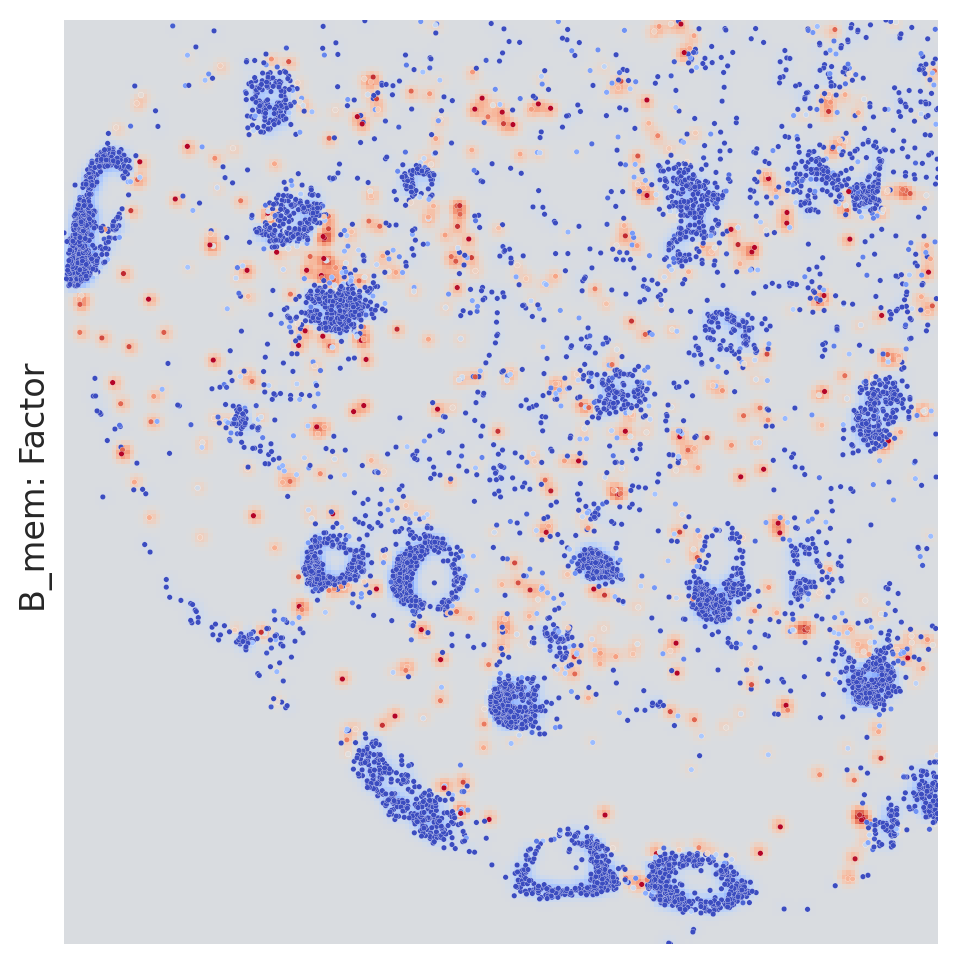

In [246]:
## kde diff: concord
draw_kde_diff(XY_loc_df, kde_comp, target_ct, Z, lims, draw_ids, score='concord',
                  use_quant=0.99, draw_points=True, cmap=mpl.colormaps['coolwarm'], 
                  ylabel=f'{target_ct}: Factor ', fs=12, title=None, figsize=(7, 6), dpi=200)

In [100]:
## sub cell type count of one factor
subct_comp = 6
score_df = XY_loc_df.copy()
subcts = [x for x in score_df.sub_cell_type.unique() if x.startswith('B')]
count_df = sub_ct_enrich(subct_comp, score_df, subcts, score='concord', q1=0.9, q2=0.95)
count_df

,base,obs_high_09,obs_high_095,exp_high_09,exp_high_095,fold_09,fold_095
sub_cell_type,,,,,,,
B_preGC,648,92,55,64,32,1.437500,1.718750
B_mem,5749,579,287,575,287,1.006957,1.000000
B_IFN,681,58,28,68,34,0.852941,0.823529
B_naive,933,73,33,93,46,0.784946,0.717391
B_activated,124,12,4,12,6,1.000000,0.666667


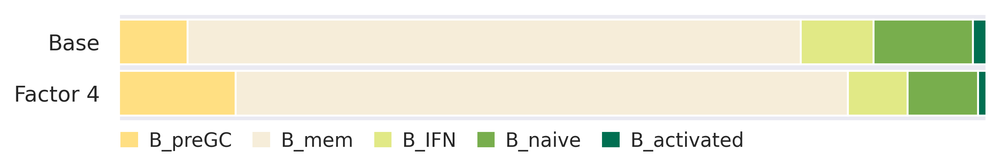

In [101]:
## sub cell type proportion of this factor
sns.set_theme(style="darkgrid")
# colors = mpl.colormaps['Set2'].colors
color_map = {'B_activated': '#006F51',
             'B_naive': '#78ae4d',
             'B_IFN': '#e1e986',
             'B_preGC': '#ffdf82',
             'B_mem': '#f6edd9'}
colors = [color_map[k] for k in count_df.index.tolist()]
draw_sub_ct_prop(count_df, alphabet=False, figsize=(8,1), dpi=300, h=0.35, yticks=[0, 0.4], 
                     yticklabels=['Base', f'Factor {draw_comps.index(subct_comp)+1}'], colors=colors, ylim=(-0.22,0.62))

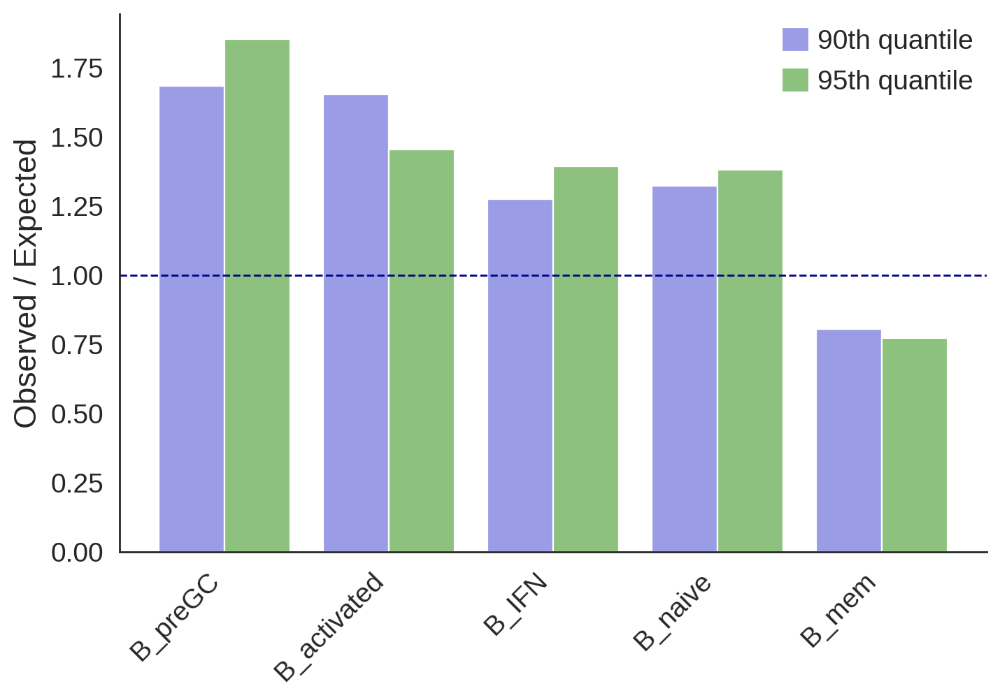

In [393]:
## enrichment folds
draw_sub_ct_enrich(count_df, figsize=(8,5), dpi=200, fs=14, width=0.4, alpha=1, title=None)

In [92]:
## combine go results
u_thres, u_top = [0.05, 0.05, 0.05, 0.05], None
# u_thres, u_top = None, 15
wdf12 = go_combine(udf, vdf, draw_comps, u_thres=u_thres, u_top=u_top, pval_thres=0.05, n_top=15, enrichr_cutoff=0.1)
print(wdf12['-log10_padj'].min(),round(wdf12['-log10_padj'].max(),1),wdf12['num_gene'].min(),round(wdf12['num_gene'].max(),1))

1 ['Endo', 'Macrophaeges'] 89 15
2 ['B_mem', 'FDC'] 102 15
4 ['B_GC', 'T'] 92 15
6 ['DC', 'T_naive'] 75 15
0.0 9.5 0.0 21.0


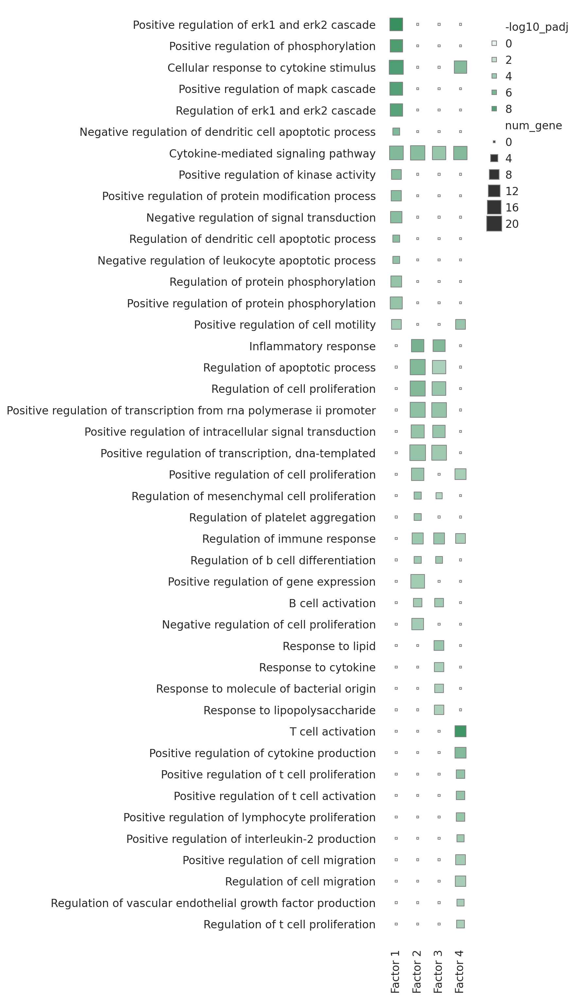

In [93]:
## draw combined go results
draw_go_combine(wdf12, draw_comps, dpi=200, sizes=(5,300), height=15,
                hue_norm=(0,np.ceil(wdf12['-log10_padj'].max())), 
                size_norm=(0,wdf12['num_gene'].max()),
                fs=12, mx=0.2, my=0.02, leg_pos=(0.76,0.98), title=None)

In [224]:
## ora
ora_comp = 'comp3'
ora_u_thres = 0.05
clist = vdf.loc[vdf[ora_comp] > 0.2].index.tolist()
print(clist)
glist = udf.loc[udf[ora_comp] > ora_u_thres].index.tolist()
print(len(glist))
enr_res = gseapy.enrichr(gene_list=glist,organism='Human',gene_sets=['GO_Biological_Process_2018'],cutoff = 0.1)
enr_res.res2d.loc[enr_res.res2d['Adjusted P-value']<0.05,['Term','Overlap','P-value','Adjusted P-value','Genes']]

['B_plasma', 'Stromal']
97


,Term,Overlap,P-value,Adjusted P-value,Genes
0,positive regulation of cell motility (GO:2000147),12/179,6.710172e-11,8.112598e-08,PDGFRB;PDGFRA;XBP1;MMP14;CXCL12;SEMA4B;LEF1;SN...
1,positive regulation of cell migration (GO:0030...,12/221,7.671108e-10,4.637185e-07,PDGFRB;PDGFRA;XBP1;MMP14;CXCL12;SEMA4B;LEF1;GA...
2,positive regulation of MAPK cascade (GO:0043410),13/289,1.442368e-09,5.812744e-07,PDGFRB;PDGFRA;ADRA2C;ADRA1A;SCIMP;ADRA2A;TNFRS...
3,regulation of cell migration (GO:0030334),13/316,4.240950e-09,1.281827e-06,PDGFRB;PDGFRA;XBP1;SEMA4B;LEF1;THBS1;ADRA2A;MY...
4,negative regulation of dendritic cell apoptoti...,4/7,1.799080e-08,4.350176e-06,CXCL12;AXL;CCL19;GAS6
5,positive regulation of ERK1 and ERK2 cascade (...,10/201,4.944687e-08,9.375755e-06,PDGFRB;PDGFRA;CD4;AXL;TNFSF11;CCL19;GAS6;ADRA1...
6,regulation of MAPK cascade (GO:0043408),10/203,5.428477e-08,9.375755e-06,PDGFRB;PDGFRA;CD4;AXL;ADRA2C;ADRA1A;EPHA3;ADRA...
7,positive regulation of intracellular signal tr...,14/479,7.693332e-08,1.162655e-05,PDGFRB;PDGFRA;GAB1;ADRA2C;ADRA1A;THBS1;ADRA2A;...
8,regulation of chemotaxis (GO:0050920),5/24,9.552988e-08,1.283285e-05,PDGFRB;PDGFRA;ADGRA2;CCL19;THBS1
9,regulation of dendritic cell apoptotic process...,4/10,1.067480e-07,1.290583e-05,CXCL12;AXL;CCL19;GAS6


In [ ]:
gseapy.barplot(enr_res.res2d,title=f'{target_ct}: {ora_comp} (u > {ora_u_thres})', top_term=20, cutoff=0.05)

## B_GC

In [142]:
## run method
target_ct = 'B_GC'
target_ct_abbr = target_ct
use_cov_test_genes = True
udf, vdf, meta = run_method(crop, target_ct,  target_ct_abbr, self=True,
                       sigma=20, cutoff=0.05, sort_comp_by_corr=False, max_cand_genes=500,
                       n_hvg=3000, cov_thres=0.05, cov_test_null=True,
                       use_cov_test_genes=use_cov_test_genes,
                       cca_comp=10, px=0.6, pz=0.5)

***** Niche matrix *****
13 cell_types.
num_cell_ID: (80534, 13).
Use other 13 cell types.
4650 B_GC, 80534 cells in total.

***** Cov test *****
sparkx_X: (2976, 4650); sparkx_N: (4650, 13)
2976 / 2976 genes have pvalue.
Cov test on permuted data...
813 genes with p_adj < 0.05.
Use top 500 genes with p_adj < 0.05.

***** CCA *****
cca_X: (4650, 500); cca_N: (4650, 13)
Nonneg CCA cors: [0.609 0.801 0.55  0.463 0.477 0.447 0.547 0.422 0.    0.   ]
udf: (500, 10); vdf: (13, 10).

B_GC: Finished in 13.0s.


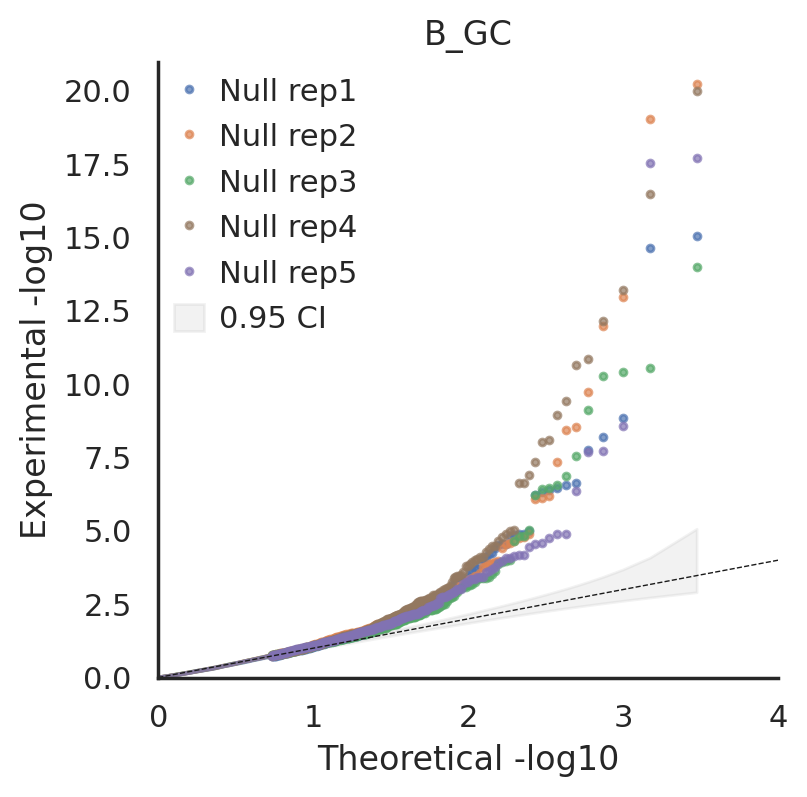

In [107]:
## qqplot: null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=200)
qqplot(meta['cov_test_qqplot_data'][1:], [f'Null rep{i}' for i in range(1,6)], 
       color=['C0', 'C1', 'C2', 'C5', 'C4'], shape=['.','.','.','.','.'], distribution='beta', ax=ax, title=target_ct)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

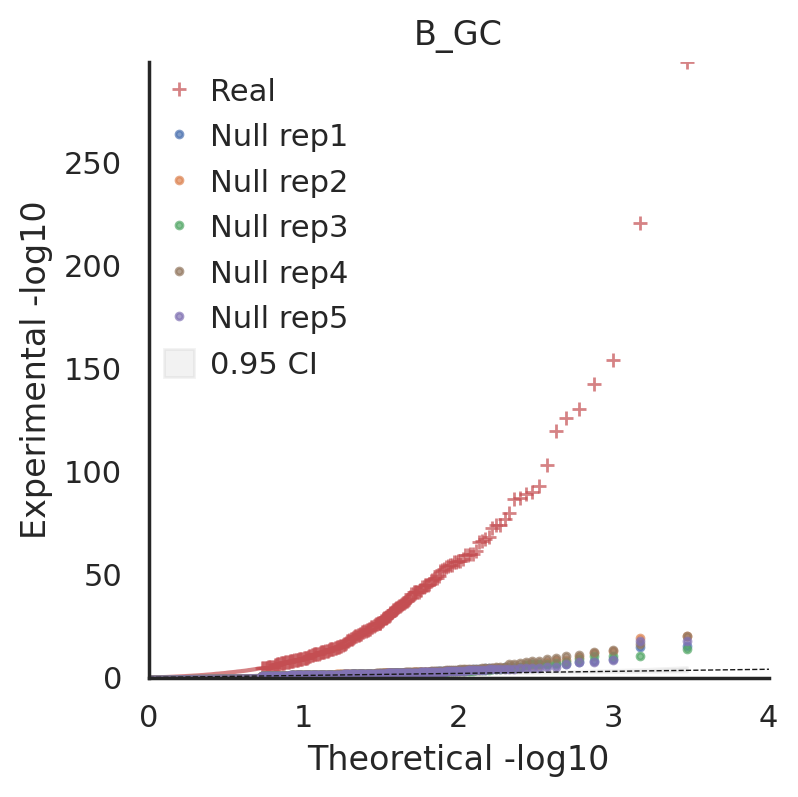

In [108]:
## qqplot: real and null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=200)
qqplot(meta['cov_test_qqplot_data'], ['Real']+[f'Null rep{i}' for i in range(1,6)], 
       color=['C3', 'C0', 'C1', 'C2', 'C5', 'C4'], shape=['+','.','.','.','.','.'], distribution='beta', ax=ax, title=target_ct)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

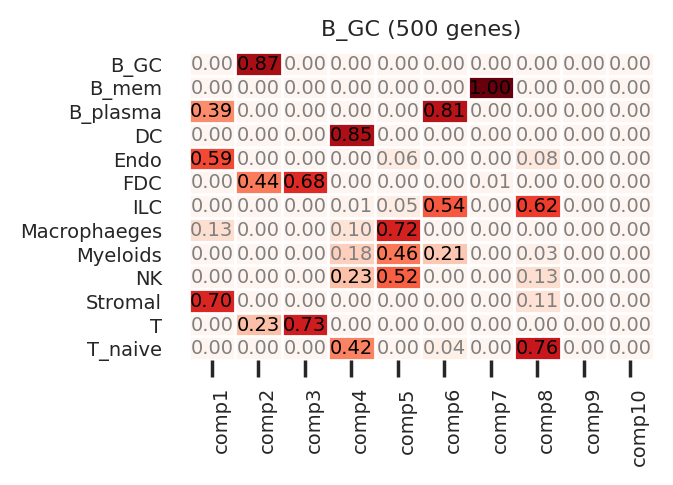

In [143]:
## v heatmap
sns.set_theme(style="white")
draw_v_heatmap(vdf, figsize=(3,2), title=f'{target_ct} ({len(udf)} genes)')

In [110]:
## select comps
draw_comps = [2,3,4,5]

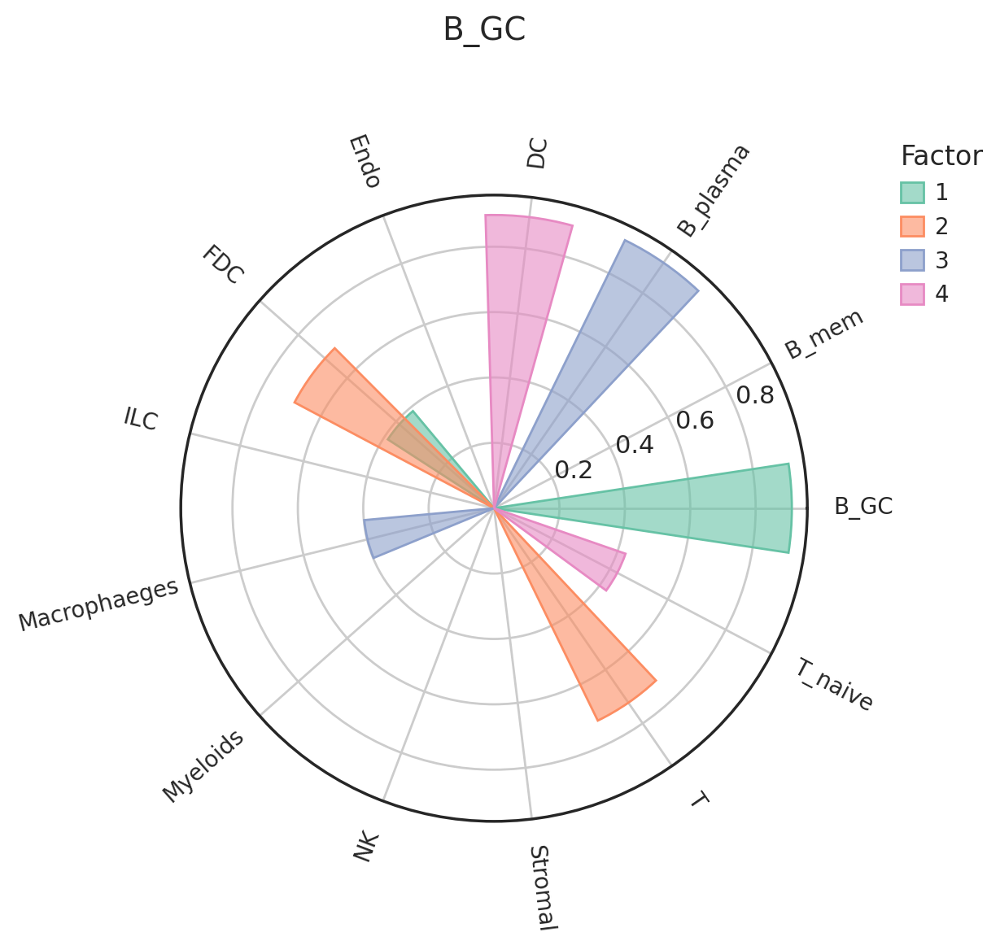

In [111]:
## v circular
sns.set_theme(style='white')
draw_v_circular(vdf, draw_comps, v_thres=0.2, cmap=mpl.colormaps['Set2'], figsize=(5,5), dpi=200, title=target_ct)

In [112]:
## niche scores
XY_loc_df = compute_score(crop, udf, vdf, target_ct, meta['N_target'], meta['loc_target'], meta['use_group_ids'])

Computed niche-related scores: XY_loc_df (4650, 534).


In [751]:
## save result
save_objs = {'udf': udf,
             'vdf': vdf,
             'meta': meta,
             'XY_loc_df': XY_loc_df}
filename = f'crop{crop_id}_{target_ct}.pkl'
with open(f'{save_dir}/{filename}', 'wb') as f:
    pickle.dump(save_objs, f)

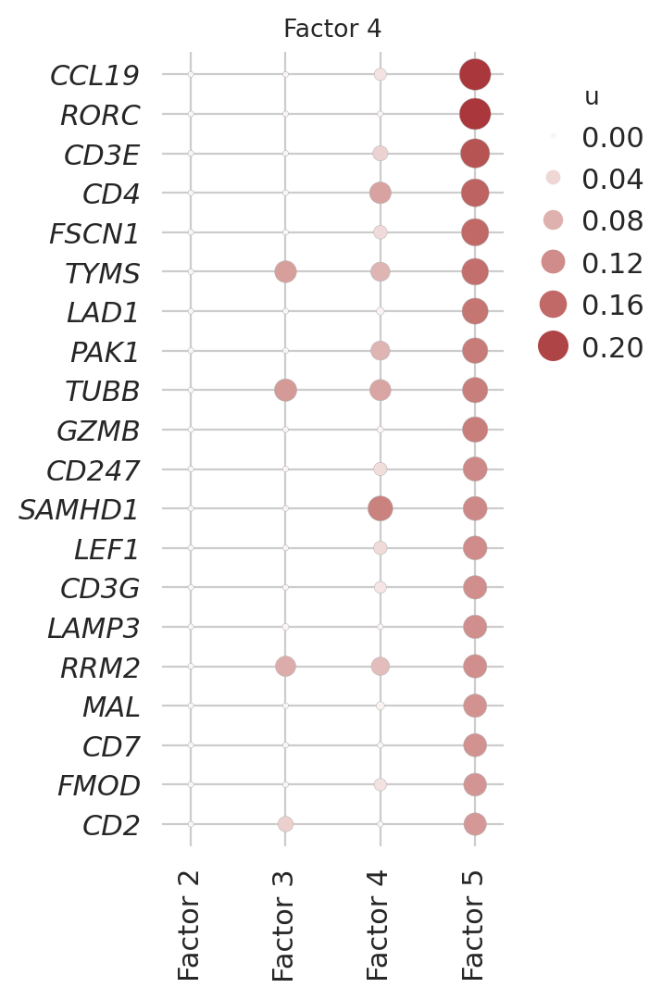

In [141]:
## u dotmap
focus_comp = 5
n_top_gene = 20
h = 0.25 * n_top_gene
u_title = f"Factor {draw_comps.index(focus_comp)+1}"
xticklabels = [f"Factor {x}" for x in draw_comps]
draw_u_dotmap(udf, focus_comp, draw_comps, n_top_gene, (5, 150), xticklabels,
                fs=11, h=h, w=3, title=u_title, mx=0.1, my=0.03, leg_pos=(1.1,0.95), dpi=200)

In [128]:
## kde diff: concord
kde_comp = 5
t0 = time.time()
Z, lims, draw_ids = kde_diff(XY_loc_df, kde_comp, score='concord', z_quantile=0.99, bw=20)
print(f'KDE diff: {time.time() - t0:.1f}s')

KDE diff: 40.4s


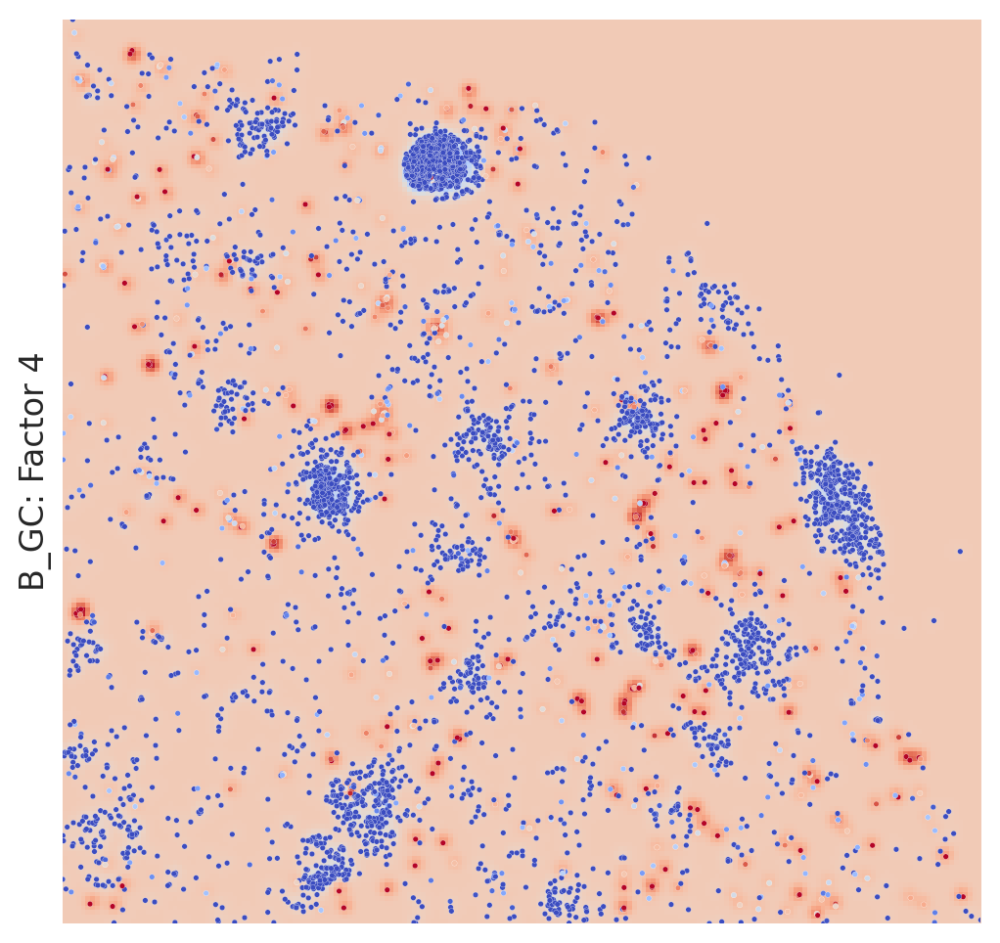

In [129]:
## kde diff: concord
draw_kde_diff(XY_loc_df, kde_comp, target_ct, Z, lims, draw_ids, score='concord',
                  use_quant=0.99, draw_points=True, cmap=mpl.colormaps['coolwarm'], 
                  ylabel=f'{target_ct}: Factor {draw_comps.index(kde_comp)+1}', fs=12, title=None, figsize=(7, 6), dpi=200)

In [136]:
## sub cell type count of one factor
subct_comp = 5
score_df = XY_loc_df.copy()
subcts = [x for x in score_df.sub_cell_type.unique() if x.startswith('B')]
count_df = sub_ct_enrich(subct_comp, score_df, subcts, score='concord', q1=0.9, q2=0.95)
count_df

,base,obs_high_09,obs_high_095,exp_high_09,exp_high_095,fold_09,fold_095
sub_cell_type,,,,,,,
B_Cycling,1897,405,218,189,95,2.142857,2.294737
B_GC_LZ,1991,44,11,199,99,0.221106,0.111111
B_GC_DZ,762,16,4,76,38,0.210526,0.105263


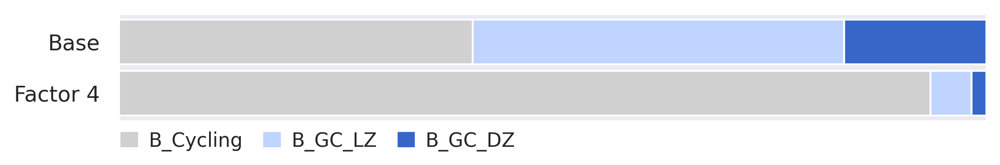

In [137]:
## sub cell type proportion of this factor
sns.set_theme(style="darkgrid")
# colors = mpl.colormaps['Set2'].colors
color_map = {'B_GC_LZ': '#bfd4ff',
             'B_GC_prePB': '#848596',
             'B_GC_DZ': '#3666C8',
             'B_Cycling': '#D0D0D0'}
colors = [color_map[k] for k in count_df.index.tolist()]
draw_sub_ct_prop(count_df, alphabet=False, figsize=(8,1), dpi=300, h=0.35, yticks=[0, 0.4], 
                     yticklabels=['Base', f'Factor {draw_comps.index(subct_comp)+1}'], colors=colors, ylim=(-0.22,0.62))

In [ ]:
## enrichment folds
draw_sub_ct_enrich(count_df, figsize=(8,5), dpi=200, fs=14, width=0.4, alpha=1, title=None)

In [116]:
## combine go results
u_thres, u_top = [0.05, 0.05, 0.05, 0.05], None
# u_thres, u_top = None, 15
wdf12 = go_combine(udf, vdf, draw_comps, u_thres=u_thres, u_top=u_top, pval_thres=0.05, n_top=15, enrichr_cutoff=0.1)
print(wdf12['-log10_padj'].min(),round(wdf12['-log10_padj'].max(),1),wdf12['num_gene'].min(),round(wdf12['num_gene'].max(),1))

2 ['B_GC', 'FDC'] 115 15
3 ['FDC', 'T'] 83 15
4 ['B_plasma', 'Macrophaeges'] 115 15
5 ['DC', 'T_naive'] 101 15
0.0 9.1 0.0 20.0


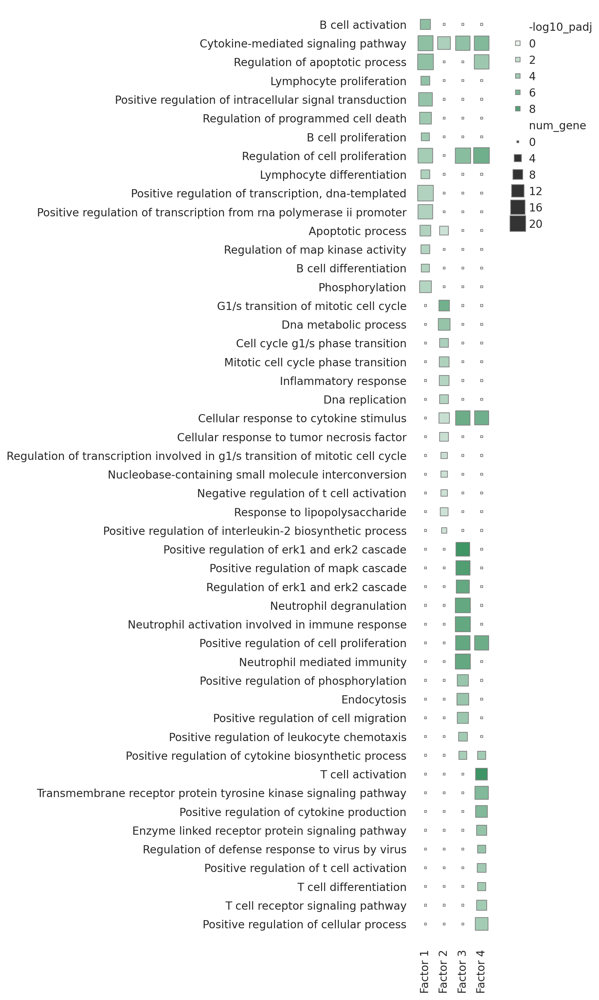

In [117]:
## draw combined go results
draw_go_combine(wdf12, draw_comps, dpi=200, sizes=(5,300), height=15,
                hue_norm=(0,np.ceil(wdf12['-log10_padj'].max())), 
                size_norm=(0,wdf12['num_gene'].max()),
                fs=12, mx=0.2, my=0.02, leg_pos=(0.77,0.98), title=None)

In [121]:
## ora
ora_comp = 'comp4'
ora_u_top = 15
ora_u_thres = 0.05
clist = vdf.loc[vdf[ora_comp] > 0.2].index.tolist()
print(clist)
glist = udf.loc[udf[ora_comp] > ora_u_thres].index.tolist()
# tmp = udf.sort_values(ora_comp, ascending=False).iloc[:ora_u_top]
# glist = tmp.index.tolist()
# print(len(glist), tmp[ora_comp].min(), tmp[ora_comp].max())
enr_res = gseapy.enrichr(gene_list=glist,organism='Human',gene_sets=['GO_Biological_Process_2018'],cutoff = 0.1)
enr_res.res2d.loc[enr_res.res2d['Adjusted P-value']<0.1,['Term','Overlap','P-value','Adjusted P-value','Genes']]

['B_plasma', 'Macrophaeges']


,Term,Overlap,P-value,Adjusted P-value,Genes
0,positive regulation of ERK1 and ERK2 cascade (...,15/201,6.322646e-13,8.788479e-10,CCL14;PDGFRA;CSF1R;NRP1;ARRB1;ARRB2;NPNT;ADRA1...
1,positive regulation of MAPK cascade (GO:0043410),16/289,9.904844e-12,6.883867e-09,CCL14;PDGFRA;CSF1R;NRP1;ARRB1;ARRB2;NPNT;ADRA1...
2,regulation of ERK1 and ERK2 cascade (GO:0070372),14/247,1.562524e-10,7.084744e-08,CCL14;PDGFRA;CSF1R;NRP1;ARRB1;ARRB2;NPNT;ADRA1...
3,neutrophil degranulation (GO:0043312),18/479,2.734337e-10,7.084744e-08,CD93;ANXA2;CLEC12A;TUBB;HEXB;PYGL;CFP;TMEM173;...
4,neutrophil activation involved in immune respo...,18/483,3.125418e-10,7.084744e-08,CD93;ANXA2;CLEC12A;TUBB;HEXB;PYGL;CFP;TMEM173;...
5,positive regulation of cell proliferation (GO:...,17/424,3.343208e-10,7.084744e-08,CCL14;PDGFRA;CSF1R;XBP1;LIFR;THBS1;TNFSF13B;TG...
6,neutrophil mediated immunity (GO:0002446),18/487,3.567857e-10,7.084744e-08,CD93;ANXA2;CLEC12A;TUBB;HEXB;PYGL;CFP;TMEM173;...
7,cellular response to cytokine stimulus (GO:007...,17/456,1.013918e-09,1.761683e-07,CCL14;CSF1R;XBP1;CSF3R;SELPLG;LIFR;NPNT;CXCL2;...
8,regulation of cell proliferation (GO:0042127),19/740,4.288362e-08,6.623137e-06,CCL14;PDGFRA;CSF1R;XBP1;LIFR;KLF4;CXCL2;ADRA1A...
9,cytokine-mediated signaling pathway (GO:0019221),17/633,1.264043e-07,1.757019e-05,CCL14;CSF1R;CSF3R;ANXA2;LIFR;SAMHD1;CXCL2;LMNB...


<Axes: title={'center': 'B_GC: comp2 (u > 0.1)'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

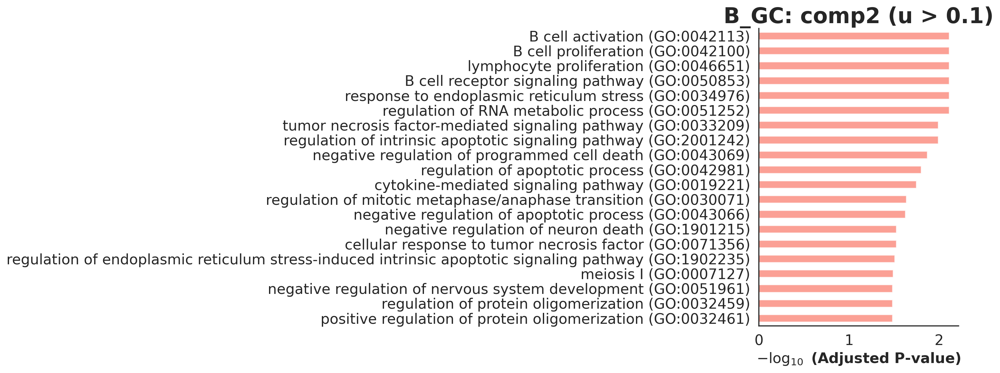

In [760]:
gseapy.barplot(enr_res.res2d,title=f'{target_ct}: {ora_comp} (u > {ora_u_thres})', top_term=20, cutoff=0.05)

## B_plasma